In [7]:
import numpy as np
import pandas as pd
import scipy.stats as stats
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels
import statsmodels.api as sm
import statsmodels.formula.api as smf
import plotly.express as px
from urllib.request import urlopen
from statsmodels.tsa.stattools import acf
import json
import itertools

In [8]:
def standardize(df):
    return (df - df.mean()) / df.std()

### Data Import & EDA

In [9]:
data = pd.read_csv('data.csv')
data.head(10)

,Census Tract,Total Population,California County,ZIP,Approximate Location,Longitude,Latitude,CES 4.0 Score,CES 4.0 Percentile,CES 4.0 Percentile Range,...,Linguistic Isolation Pctl,Poverty,Poverty Pctl,Unemployment,Unemployment Pctl,Housing Burden,Housing Burden Pctl,Pop. Char.,Pop. Char. Score,Pop. Char. Pctl
0,6019001100,2780,Fresno,93706,Fresno,-119.781696,36.709695,93.18,100.00,95-100% (highest scores),...,79.37,76.0,98.92,12.8,93.83,30.3,91.04,93.16,9.66,99.72
1,6077000700,4680,San Joaquin,95206,Stockton,-121.287873,37.943173,86.65,99.99,95-100% (highest scores),...,95.53,73.2,98.39,19.8,99.21,31.2,92.28,93.17,9.66,99.74
2,6037204920,2751,Los Angeles,90023,Los Angeles,-118.197497,34.017500,82.39,99.97,95-100% (highest scores),...,81.55,62.6,93.39,6.4,61.53,20.3,63.97,83.75,8.69,95.79
3,6019000700,3664,Fresno,93706,Fresno,-119.827707,36.734535,81.33,99.96,95-100% (highest scores),...,78.71,65.7,95.35,15.7,97.35,35.4,96.41,94.64,9.82,99.89
4,6019000200,2689,Fresno,93706,Fresno,-119.805504,36.735491,80.75,99.95,95-100% (highest scores),...,86.56,72.7,98.30,13.7,95.29,32.7,94.16,95.40,9.90,99.95
5,6037542402,3306,Los Angeles,90221,Compton,-118.212413,33.881969,80.71,99.94,95-100% (highest scores),...,NaN,43.5,74.05,9.3,83.22,23.7,76.35,83.37,8.65,95.46
6,6019001000,4255,Fresno,93706,Fresno,-119.804314,36.697751,80.55,99.92,95-100% (highest scores),...,88.70,79.5,99.41,15.4,97.14,33.3,94.83,95.84,9.94,99.99
7,6037543202,5124,Los Angeles,90220,Compton,-118.230032,33.879862,79.29,99.91,95-100% (highest scores),...,60.62,56.8,88.92,12.6,93.49,29.6,89.84,85.44,8.86,96.90
8,6019001202,4561,Fresno,93725,Unincorporated Fresno County area,-119.741028,36.702685,79.17,99.90,95-100% (highest scores),...,89.62,72.2,98.12,16.3,97.90,30.8,91.76,87.24,9.05,98.05
9,6077000100,3688,San Joaquin,95202,Stockton,-121.285363,37.953996,77.87,99.89,95-100% (highest scores),...,91.39,78.8,99.31,14.6,96.46,33.1,94.64,95.83,9.94,99.97


In [10]:
clean = data[['Total Population', 'California County', 'ZIP', 'Poverty', 'Lead', 'Pollution Burden', 'Asthma', 'Linguistic Isolation', 'Education']].sort_values('Poverty', ascending=False)
clean['Linguistic_Isolation'] = clean['Linguistic Isolation']
clean['Pollution_Burden'] = clean['Pollution Burden']

clean.drop(columns=['Pollution Burden', 'Linguistic Isolation'])

columns = ['Poverty', 'Lead', 'Pollution_Burden', 'Asthma', 'Linguistic_Isolation', 'Education']
std_clean = clean
std_clean = (clean[columns] - clean[columns].mean()) / clean[columns].std()

In [11]:
sd = clean[clean['California County'] == 'San Diego']
la = clean[clean['California County'] == 'Los Angeles']

sd_la = pd.concat([sd, la]).dropna()
sd_la['Is_La'] = sd_la['California County'] == 'Los Angeles'

sd_la.shape

(2845, 12)

# San Diego & Los Angeles Exploration

Text(0.5, 1.0, 'San Diego Versus Los Angeles Poverty Levels')

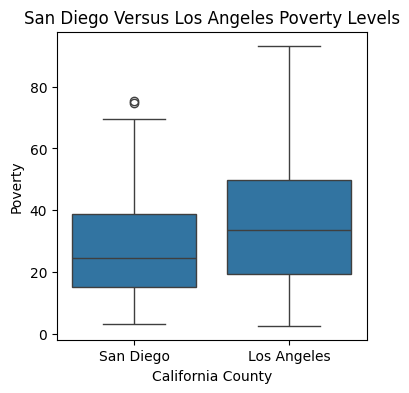

In [12]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sns.boxplot(x='California County', y='Poverty', data=sd_la, ax=ax).set_title("San Diego Versus Los Angeles Poverty Levels")

Text(0, 0.5, 'Education Levels in San Diego')

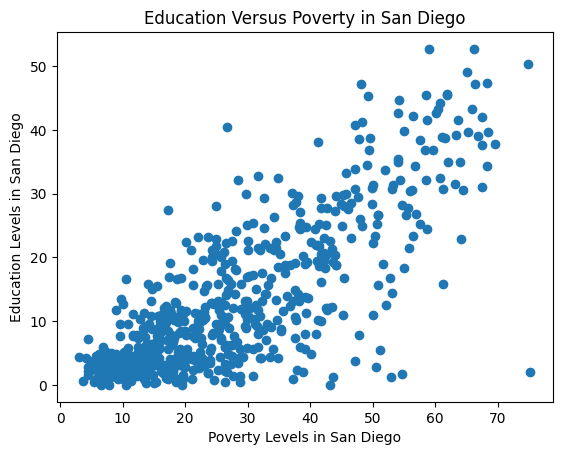

In [13]:
plt.scatter(x=sd['Poverty'],y=sd['Education'])
plt.title("Education Versus Poverty in San Diego")
plt.xlabel("Poverty Levels in San Diego")
plt.ylabel("Education Levels in San Diego")

Text(0, 0.5, 'Education Levels in Los Angeles')

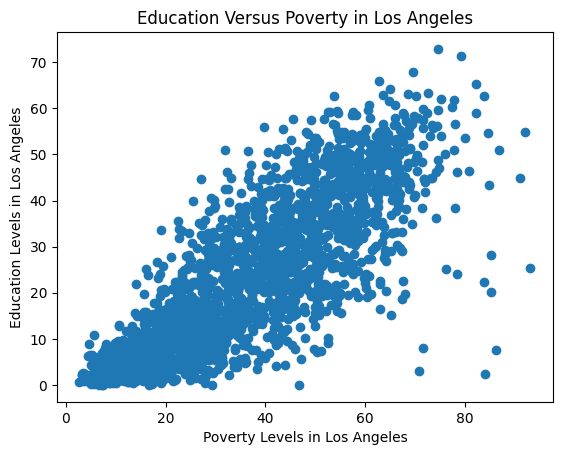

In [14]:
plt.scatter(x=la['Poverty'],y=la['Education'])
plt.title("Education Versus Poverty in Los Angeles")
plt.xlabel("Poverty Levels in Los Angeles")
plt.ylabel("Education Levels in Los Angeles")

Text(0, 0.5, 'Education Levels in San Diego and Los Angeles')

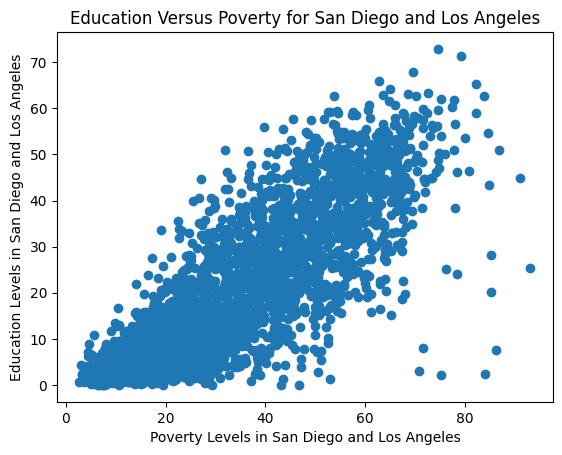

In [15]:
plt.scatter(x=sd_la['Poverty'],y=sd_la['Education'])
plt.title("Education Versus Poverty for San Diego and Los Angeles")
plt.xlabel("Poverty Levels in San Diego and Los Angeles")
plt.ylabel("Education Levels in San Diego and Los Angeles")

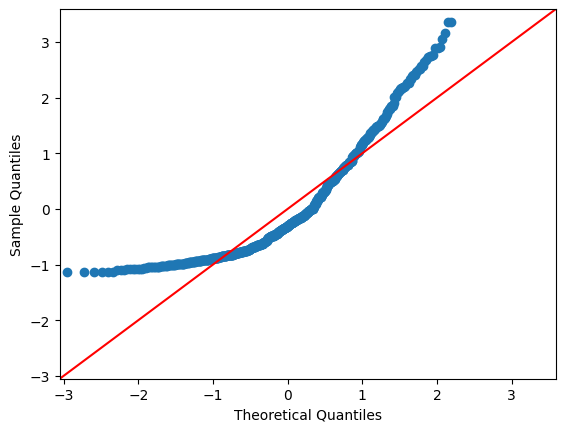

In [16]:
hide = sm.qqplot((standardize(sd['Education'])), stats.norm, line='45')

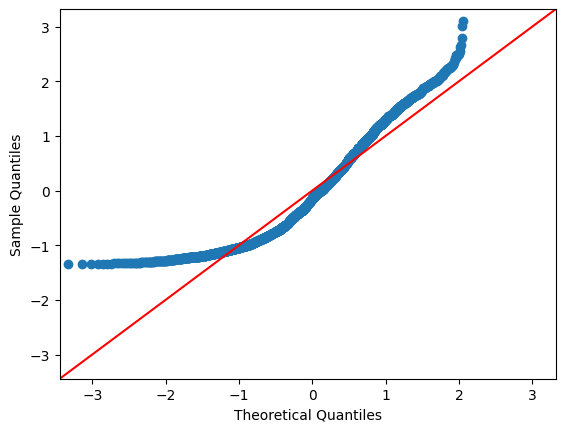

In [17]:
hide = sm.qqplot((standardize(la['Education'])), stats.norm, line='45')

Text(0.5, 1.0, "Histogram of San Diego's Education Levels")

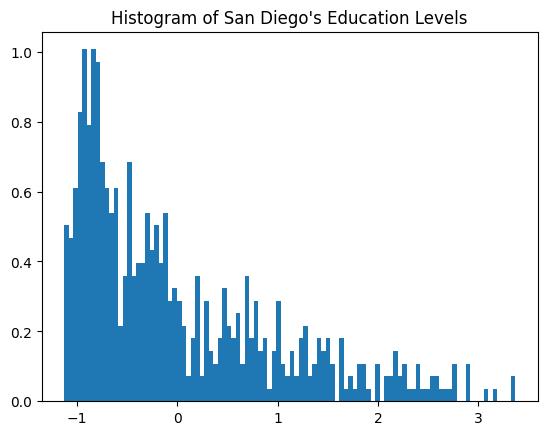

In [18]:
plt.hist(standardize(sd['Education']), bins=100, density=True)
plt.title("Histogram of San Diego's Education Levels")

In [19]:
plt.hist(standardize(la['Education']), bins=100, density=True)
plt.title("Histogram of Los Angeles's Education Levels")

Text(0.5, 1.0, "Histogram of Los Angeles's Education Levels")

In [ ]:
model_sd = smf.ols('Poverty ~ Education', sd).fit()
print(model_sd.summary().tables[1])

                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     13.7447      0.603     22.792      0.000      12.560      14.929
Education      1.0784      0.034     31.615      0.000       1.011       1.145


In [ ]:
model_la = smf.ols('Poverty ~ Education', la).fit()
print(model_la.summary().tables[1])

                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     14.7315      0.367     40.162      0.000      14.012      15.451
Education      0.9206      0.013     69.202      0.000       0.894       0.947


In [ ]:
model_sd_la = smf.ols('Poverty ~ Education + C(Is_La)', sd_la).fit()

Text(0, 0.5, 'Education Levels in San Diego and Los Angeles')

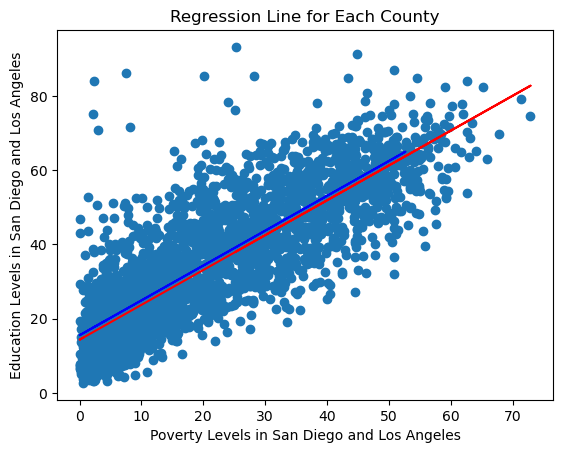

In [ ]:
plt.scatter(sd_la['Education'], sd_la['Poverty'])
plt.plot(sd_la['Education'][sd_la.Is_La == 0], model_sd_la.predict(sd_la[sd_la.Is_La == 0]), color='blue')
plt.plot(sd_la['Education'][sd_la.Is_La == 1], model_sd_la.predict(sd_la[sd_la.Is_La == 1]), color='red')
plt.title("Regression Line for Each County")
plt.xlabel("Poverty Levels in San Diego and Los Angeles")
plt.ylabel("Education Levels in San Diego and Los Angeles")

To address nan values in our observations, we dropped rows where values for education are missing. There is negligible data loss -- namely, 54 from ~2950 rows.

The most highly correlated variables were:

- Lead: 0.64
- Pollution Burden: 0.44
- Asthma: 0.44
- Linguistic Iso.: 0.71
- Poverty: 0.78
- Unemployment: 0.39
- Housing Burden: 0.53
- Cardiovascular Disease: 0.47

But to reduce multicollinearity we narrowed it down to five variables:

- Lead: 0.64
- Pollution Burden: 0.44
- Asthma: 0.44
- Linguistic Isolation: 0.71
- Poverty: 0.78

Thus, our model formula was 
$$\hat{\text{Education}} = \beta_{0} + \beta_{1}\text{Lead} + \beta_{2}\text{Pollution Burden} + \beta_{3}\text{Asthma} + \beta_{4} \text{Linguistic Isolation} + \beta_{5} \text{Poverty}$$

In [ ]:
def present(feature_x, feature_y):
    plt.scatter(x=sd_la[feature_x],y=sd_la[feature_y])

In [ ]:
'Ozone', 'PM2.5', 'Diesel PM', 'Drinking Water', 'Lead', 'Pesticides', 
'Tox. Release', 'Traffic', 'Cleanup Sites', 'Groundwater Threats', 
'Haz. Waste', 'Imp. Water Bodies', 'Solid Waste', 'Pollution Burden',
'Asthma', 'Asthma Pctl', 'Low Birth Weight',  


'Linguistic Isolation', 'Poverty', 'Unemployment', 'Housing Burden', 
'Pop. Char. ', 'Cardiovascular Disease', 'Education'

('Pop. Char. ', 'Cardiovascular Disease', 'Education')

<Axes: >

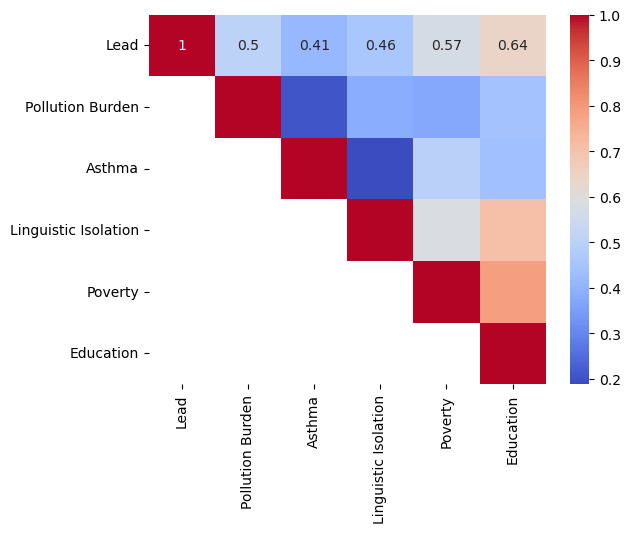

In [ ]:
drop_data = data[['Lead', 'Pollution Burden', 'Asthma', 'Linguistic Isolation', 'Poverty', 'Education']]
variables = drop_data.columns
corr_table = drop_data[variables].corr() 
sns.heatmap(corr_table, annot=True, cmap='coolwarm', mask=np.tril(corr_table, k=-1))

## San Diego and Los Angeles Poverty Distribution
We want to know whether the poverty levels in San Diego and Los Angeles come from the same distribution. To answer this question, we will use the Wald-Wolfowitz runs test. The **Wald-Wolfowitz runs test** is a nonparametric test for two independent samples. The test is used to determine if the two samples are from the same distribution, as mentioned in lecture. 

In [ ]:
R, pvalue = statsmodels.sandbox.stats.runs.runstest_2samp(
    sd['Poverty'], 
    la['Poverty']
)
alpha = 0.05
if pvalue < alpha:
    print("REJECT NULL")
else:
    print("FAIL TO REJECT NULL")

REJECT NULL


Interestingly, this seems to suggest there evidence that the distribution of poverty in San Diego and Los Angeles are different. For the small level of alpha, we could test whether the two-sample K-S Test agrees with the results above.


In [ ]:
KS_result = stats.kstest(sd['Poverty'], la['Poverty'])
if KS_result.pvalue < alpha:
    print("REJECT NULL")
else:
    print("FAIL TO REJECT NULL")

REJECT NULL


The results seem to agree again implying their is evidence for the alternate hypothesis.

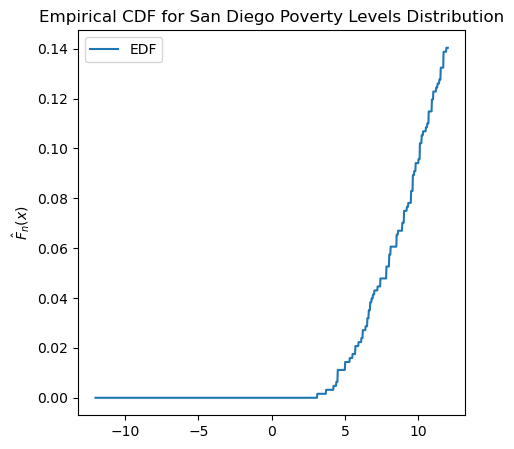

In [ ]:
xrange = np.linspace(-12, 12, 1000)
sd_ecdf= np.array([sum(sd['Poverty'] < x) for x in xrange]) / len(sd)
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
ax.plot(xrange, sd_ecdf, label='EDF')
ax.set_ylabel(r'$\hat F_n(x)$')
ax.set_title("Empirical CDF for San Diego Poverty Levels Distribution")
ax.legend()

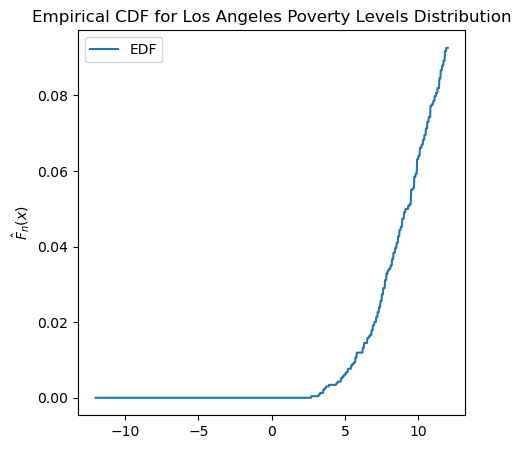

In [ ]:
xrange = np.linspace(-12, 12, 1000)
la_ecdf= np.array([sum(la['Poverty'] < x) for x in xrange]) / len(la)
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
ax.plot(xrange, la_ecdf, label='EDF')
ax.set_ylabel(r'$\hat F_n(x)$')
ax.set_title("Empirical CDF for Los Angeles Poverty Levels Distribution")
ax.legend()

### Shapiro-Wilk Test

We can run the shapiro-wilk test to check if our data is normally distributed.

#### SD Shapiro-Wilk test

In [ ]:
sd_pvalue = stats.shapiro(sd['Poverty']).pvalue
if sd_pvalue < alpha:
    print("REJECT NULL")
else:
    print("FAIL TO REJECT NULL")

FAIL TO REJECT NULL


#### LA Shapiro-Wilk Test

In [ ]:
la_pvalue = stats.shapiro(la['Poverty']).pvalue
if la_pvalue < alpha:
    print("REJECT NULL")
else:
    print("FAIL TO REJECT NULL")

FAIL TO REJECT NULL


We do not have enough evidence to conclude that both poverty levels in San Diego and Los Angeles do not follow a normal distribution for an alpha level of .05

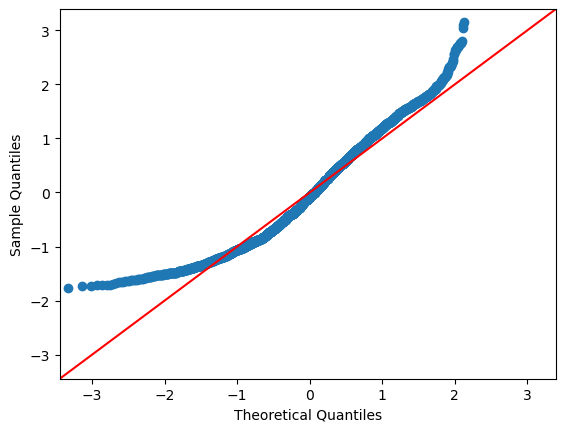

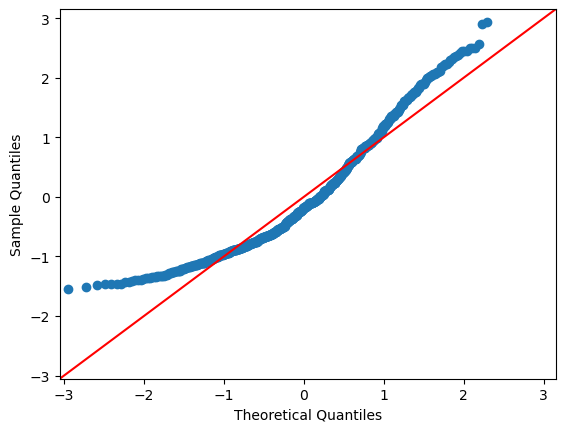

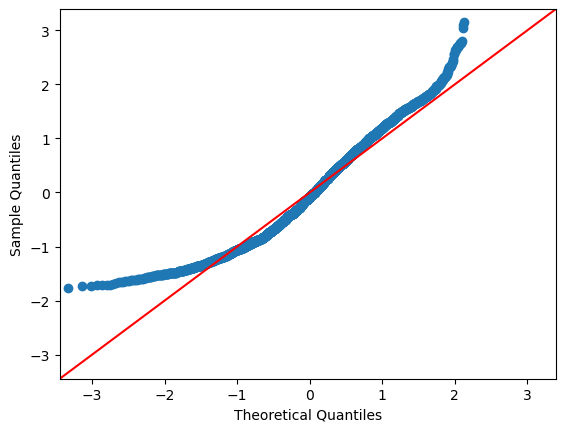

In [ ]:
sm.qqplot((standardize(sd['Poverty'])), stats.norm, line='45')
sm.qqplot((standardize(la['Poverty'])), stats.norm, line='45')

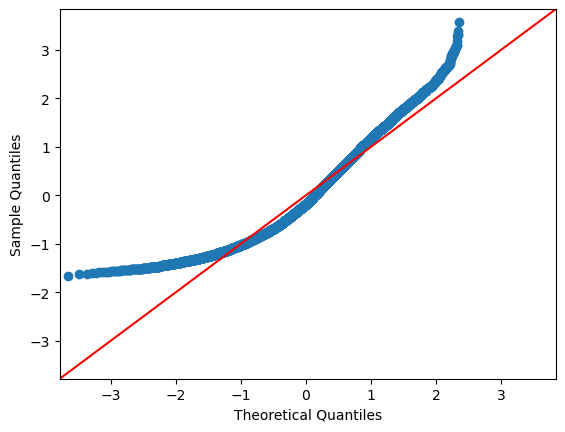

In [ ]:
hide = sm.qqplot(std_clean['Poverty'], stats.norm, line='45')

## Fitting San Diego and Los Angeles Regression Model

In [ ]:
model = smf.ols('Education ~ Poverty + Lead + Asthma + Linguistic_Isolation + Pollution_Burden', sd_la).fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Education   R-squared:                       0.777
Model:                            OLS   Adj. R-squared:                  0.776
Method:                 Least Squares   F-statistic:                     1976.
Date:                Sat, 08 Jun 2024   Prob (F-statistic):               0.00
Time:                        19:42:00   Log-Likelihood:                -9795.6
No. Observations:                2845   AIC:                         1.960e+04
Df Residuals:                    2839   BIC:                         1.964e+04
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
Intercept              -11.5485      0.619    -18.666      0.000     -12.762     -10.335
Poverty                  0.3828      0.013     28.855      0.000       0.357       0.409
Lead                     0.2206      0.009     23.963      0.000       0.203       0.239
Asthma                   0.0562      0.007      8.333      0.000       0.043       0.069
Linguistic_Isolation     0.3447      0.019     17.682      0.000       0.306       0.383
Pollution_Burden        -0.0152      0.015     -1.047      0.295      -0.044       0.013
==============================================================================
Omnibus:                        9.349   Durbin-Watson:                   1.889
Prob(Omnibus):                  0.009   Jarque-Bera (JB):               11.777
Skew:                           0.006   Prob(JB):                      0.00277
Kurtosis:                       3.315   Cond. No.                         449.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

# San Diego & Los Angeles Regression Assumptions

### Linearity & Heteroscedasticity

Text(0, 0.5, 'Model Standardized Residuals')

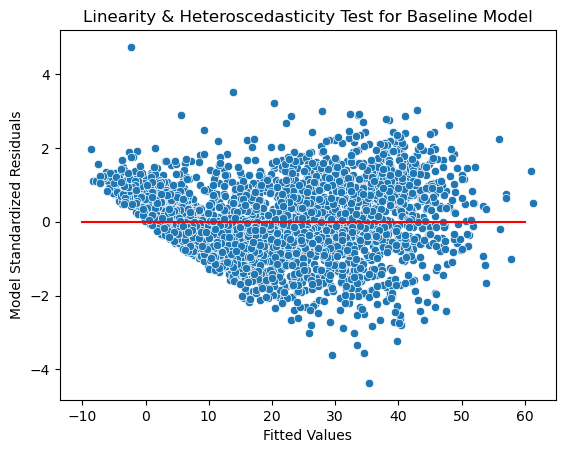

In [ ]:
sns.scatterplot(x=model.fittedvalues, y=standardize(model.resid))
plt.plot(np.linspace(-10, 60, 100), np.zeros(100), 'r')
plt.title("Linearity & Heteroscedasticity Test for Baseline Model")
plt.xlabel("Fitted Values")
plt.ylabel("Model Standardized Residuals")

### Residual Normality

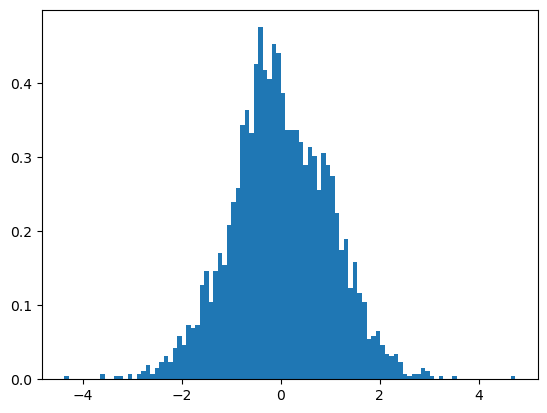

In [ ]:
hide = plt.hist(standardize(model.resid), bins=100, density=True)

In [ ]:
residuals_pvalue = stats.shapiro(standardize(model.resid)).pvalue
if residuals_pvalue < alpha:
    print("REJECT NULL")
else:
    print("FAIL TO REJECT NULL")

residuals_pvalue 

REJECT NULL


0.00238468567840755

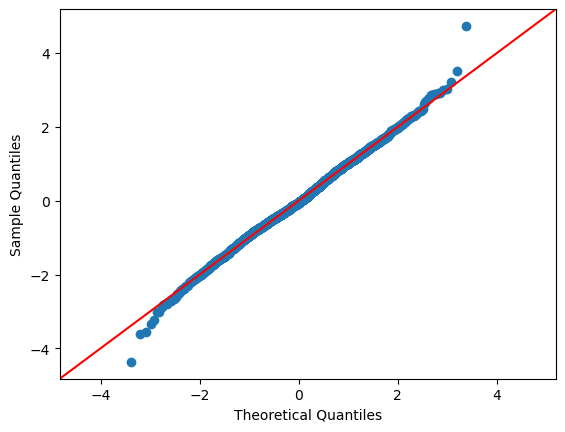

In [ ]:
qq = sm.qqplot(standardize(model.resid), stats.norm, line='45')

### Check for Independence

Text(0, 0.5, 'ACF')

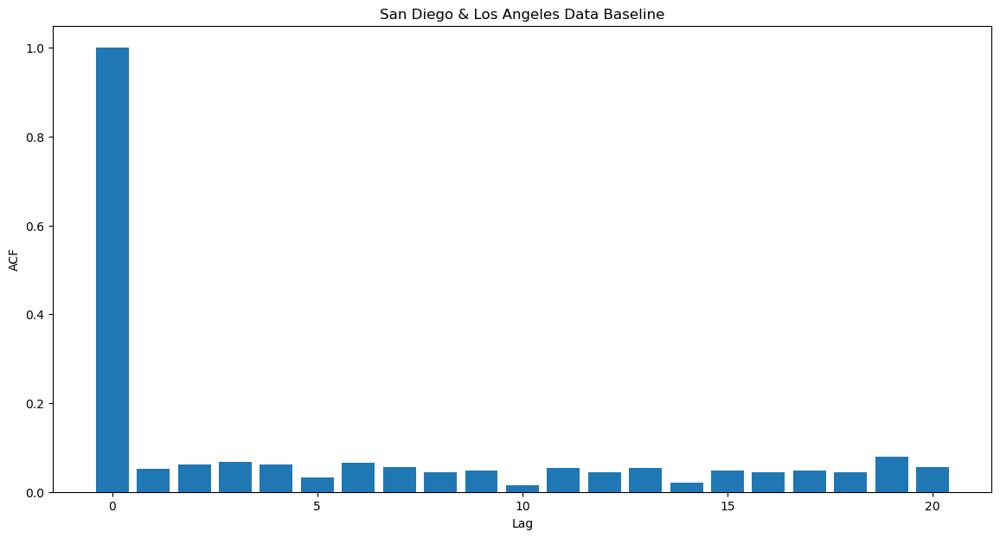

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(14, 7))

lags = 20
ax.bar(range(lags+1), acf(model.resid, nlags=lags))
ax.set_title("San Diego & Los Angeles Data Baseline")
ax.set_xlabel("Lag")
ax.set_ylabel("ACF")

### Completeness

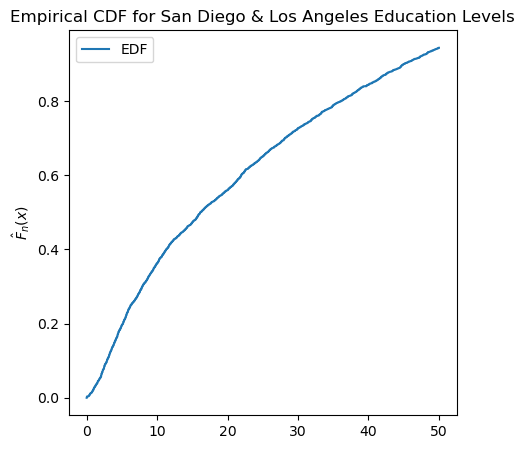

In [ ]:
xrange = np.linspace(0, 50, 1000)
sd_la_ecdf= np.array([sum(sd_la['Education'] < x) for x in xrange]) / len(sd_la)
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
ax.plot(xrange, sd_la_ecdf, label='EDF')
ax.set_ylabel(r'$\hat F_n(x)$')
ax.set_title("Empirical CDF for San Diego & Los Angeles Education Levels")
ax.legend()

## Model with Interaction Terms San Diego & Los Angeles

In [ ]:
model2 = smf.ols('Education ~ Lead + Pollution_Burden + Poverty + Linguistic_Isolation + Asthma + Linguistic_Isolation:C(Is_La) + Poverty:C(Is_La) + Asthma:C(Is_La) + Lead:C(Is_La) + Pollution_Burden:C(Is_La) + C(Is_La)', sd_la).fit()
model2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Education   R-squared:                       0.794
Model:                            OLS   Adj. R-squared:                  0.793
Method:                 Least Squares   F-statistic:                     994.2
Date:                Sat, 08 Jun 2024   Prob (F-statistic):               0.00
Time:                        19:42:02   Log-Likelihood:                -9679.9
No. Observations:                2845   AIC:                         1.938e+04
Df Residuals:                    2833   BIC:                         1.946e+04
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
=========================================================================================================
                                            coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------
Intercept                                -2.2569      1.208     -1.868      0.062      -4.626       0.113
C(Is_La)[T.True]                        -15.2551      1.457    -10.467      0.000     -18.113     -12.397
Lead                                      0.1041      0.023      4.488      0.000       0.059       0.150
Lead:C(Is_La)[T.True]                     0.1593      0.025      6.317      0.000       0.110       0.209
Pollution_Burden                         -0.0691      0.035     -1.980      0.048      -0.137      -0.001
Pollution_Burden:C(Is_La)[T.True]         0.1143      0.039      2.960      0.003       0.039       0.190
Poverty                                   0.2115      0.033      6.405      0.000       0.147       0.276
Poverty:C(Is_La)[T.True]                  0.1802      0.036      4.984      0.000       0.109       0.251
Linguistic_Isolation                      0.7806      0.065     11.927      0.000       0.652       0.909
Linguistic_Isolation:C(Is_La)[T.True]    -0.4671      0.069     -6.809      0.000      -0.602      -0.333
Asthma                                    0.0751      0.020      3.822      0.000       0.037       0.114
Asthma:C(Is_La)[T.True]                  -0.0212      0.021     -1.015      0.310      -0.062       0.020
==============================================================================
Omnibus:                       18.874   Durbin-Watson:                   1.965
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               27.065
Skew:                           0.033   Prob(JB):                     1.33e-06
Kurtosis:                       3.473   Cond. No.                     1.85e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.85e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

## Model Assumptions for Interaction Terms Model

### Linearity &  Heteroscedasticity

Text(0, 0.5, 'Model Standardized Residuals')

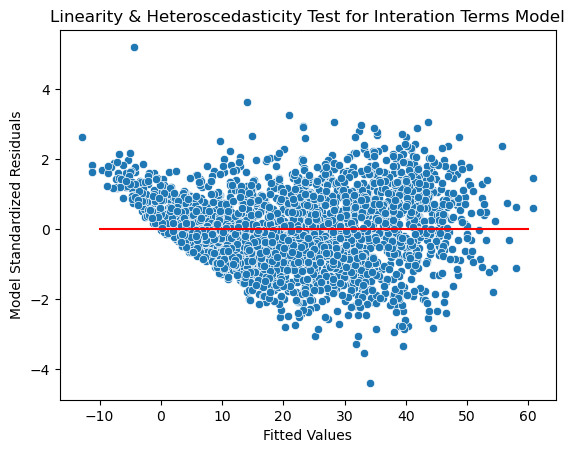

In [ ]:
sns.scatterplot(x=model2.fittedvalues, y=standardize(model2.resid))
plt.plot(np.linspace(-10, 60, 100), np.zeros(100), 'r')
plt.title("Linearity & Heteroscedasticity Test for Interation Terms Model")
plt.xlabel("Fitted Values")
plt.ylabel("Model Standardized Residuals")

### Residual Normality

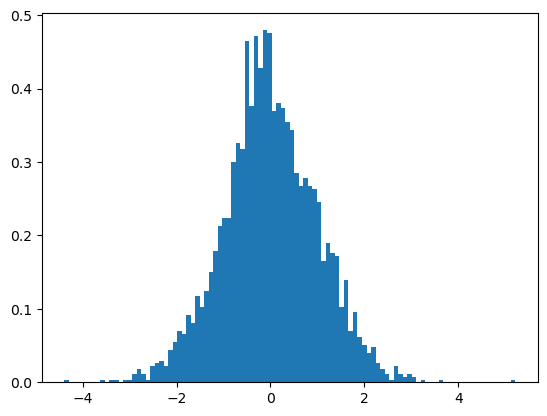

In [ ]:
hide = plt.hist(standardize(model2.resid), bins=100, density=True)

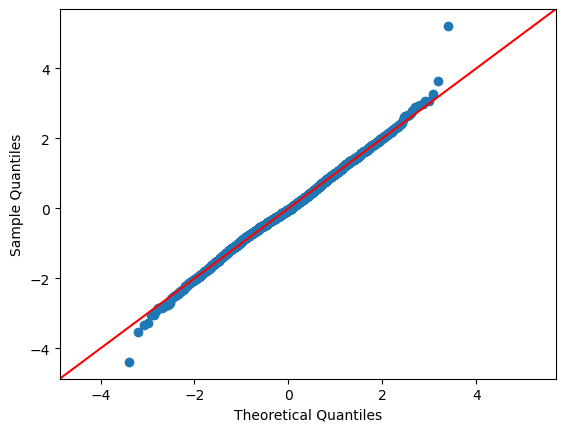

In [ ]:
qq = sm.qqplot(standardize(model2.resid), stats.norm, line='45')

In [ ]:
residuals_pvalue = stats.shapiro(standardize(model.resid)).pvalue
if residuals_pvalue < alpha:
    print("REJECT NULL")
else:
    print("FAIL TO REJECT NULL")

residuals_pvalue 

REJECT NULL


0.00238468567840755

### Check for Independence

Text(0, 0.5, 'ACF')

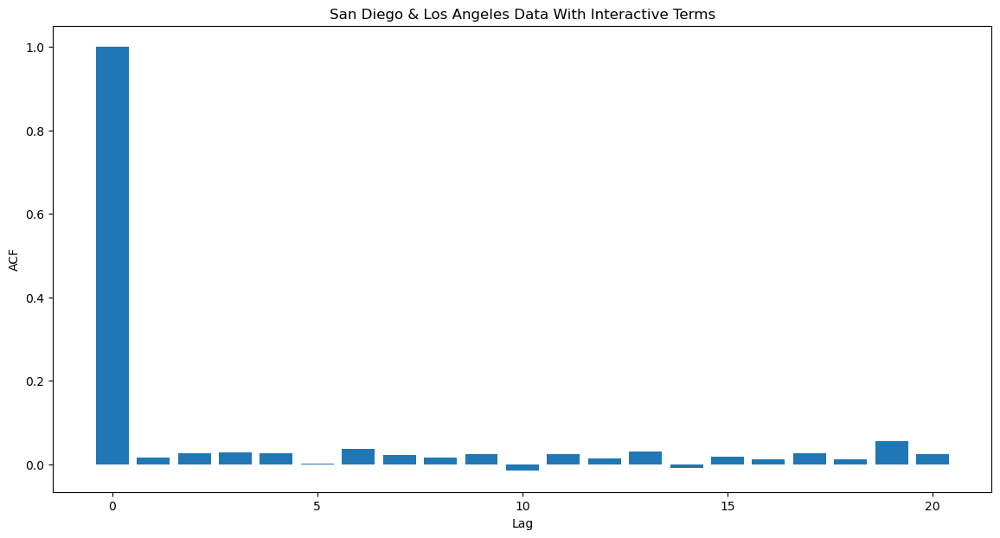

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(14, 7))

lags = 20
hide = ax.bar(range(lags+1), acf(model2.resid, nlags=lags))
ax.set_title("San Diego & Los Angeles Data With Interactive Terms")
ax.set_xlabel("Lag")
ax.set_ylabel("ACF")

### Completeness

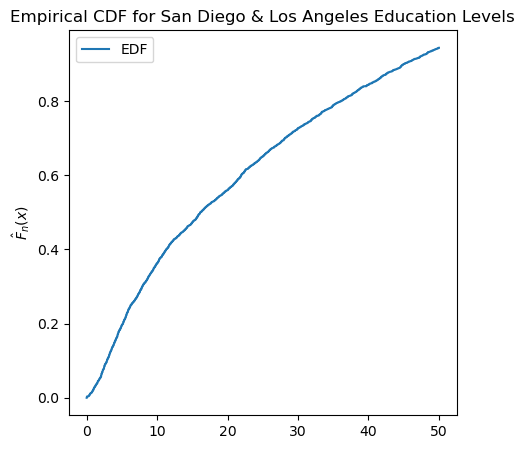

In [ ]:
xrange = np.linspace(0, 50, 1000)
sd_la_ecdf= np.array([sum(sd_la['Education'] < x) for x in xrange]) / len(sd_la)
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
ax.plot(xrange, sd_la_ecdf, label='EDF')
ax.set_ylabel(r'$\hat F_n(x)$')
ax.set_title("Empirical CDF for San Diego & Los Angeles Education Levels")
ax.legend()

In [ ]:
fip_dict = {}
us_zip = pd.read_csv('data/uszips.csv', dtype={'county_fips': str})
ca = us_zip[us_zip['state_id'] == 'CA']
for i in range(ca.shape[0]):
    fip_dict[ca['zip'].iloc[i]] = ca['county_fips'].iloc[i]

In [ ]:
def dic(x):
    if int(x) in fip_dict:
        return fip_dict[int(x)]
    return 0
clean['fip'] = clean['ZIP'].apply(dic)
clean['pred'] = pd.Series(model2.fittedvalues)

sd = clean[clean['California County'] == 'San Diego']
la = clean[clean['California County'] == 'Los Angeles']

small = pd.concat([sd, la]).dropna()

In [ ]:
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)
    
us_zip = pd.read_csv('data/uszips.csv', dtype={'county_fips': str}) 

fig = px.choropleth(small,
                    geojson=counties, 
                    locations='fip', 
                    color='Education',
                    range_color=(0, 100),
                    scope="usa"
                    )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [ ]:
fig = px.choropleth(small,
                    geojson=counties, 
                    locations='fip', 
                    #locationmode="USA-states", 
                    color='pred',
                    range_color=(0, 100),
                    scope="usa"
                    )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

# Entire Dataset Exploration

In [ ]:
data = pd.read_csv('data.csv')

In [ ]:
def fill_space(s):
    return s.replace(" ", "_").replace(".", "")

data_copy = data.copy()
for feature in data.columns:
    new_feature = fill_space(feature)
    if new_feature != feature:
        data[new_feature] = data[feature]
        data_copy[new_feature] = data_copy[feature]
        data = data.drop(columns=[feature])
        data_copy = data_copy.drop(columns=[feature])
    if 'Pctl' in feature:
        data_copy = data_copy.drop(columns=[new_feature])


In [ ]:
data = data.drop(columns=['Education_Pctl'])
data.columns

Index(['ZIP', 'Longitude', 'Latitude', 'Ozone', 'Lead', 'Pesticides',
       'Traffic', 'Asthma', 'Education', 'Poverty', 'Unemployment',
       'Census_Tract', 'Total_Population', 'California_County',
       'Approximate_Location', 'CES_40_Score', 'CES_40_Percentile',
       'CES_40_Percentile_Range', 'Ozone_Pctl', 'PM25', 'PM25_Pctl',
       'Diesel_PM', 'Diesel_PM_Pctl', 'Drinking_Water', 'Drinking_Water_Pctl',
       'Lead_Pctl', 'Pesticides_Pctl', 'Tox_Release', 'Tox_Release_Pctl',
       'Traffic_Pctl', 'Cleanup_Sites', 'Cleanup_Sites_Pctl',
       'Groundwater_Threats', 'Groundwater_Threats_Pctl', 'Haz_Waste',
       'Haz_Waste_Pctl', 'Imp_Water_Bodies', 'Imp_Water_Bodies_Pctl',
       'Solid_Waste', 'Solid_Waste_Pctl', 'Pollution_Burden',
       'Pollution_Burden_Score', 'Pollution_Burden_Pctl', 'Asthma_Pctl',
       'Low_Birth_Weight', 'Low_Birth_Weight_Pctl', 'Cardiovascular_Disease',
       'Cardiovascular_Disease_Pctl', 'Linguistic_Isolation',
       'Linguistic_Isolation_P

In [ ]:
clean = data[['ZIP', 'California_County', 'Poverty', 'Lead', 'Pollution_Burden', 'Asthma', 'Linguistic_Isolation', 'Education']].sort_values('Poverty', ascending=False)


columns = ['Poverty', 'Lead', 'Pollution_Burden', 'Asthma', 'Linguistic_Isolation', 'Education']

### Distribution of `Poverty`

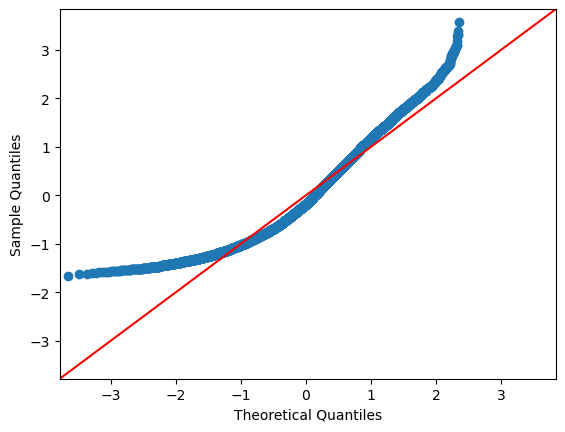

In [ ]:
hide = sm.qqplot((standardize(data['Poverty'])), stats.norm, line='45')

Text(0.5, 1.0, 'Distribution of Poverty for Entire Dataset')

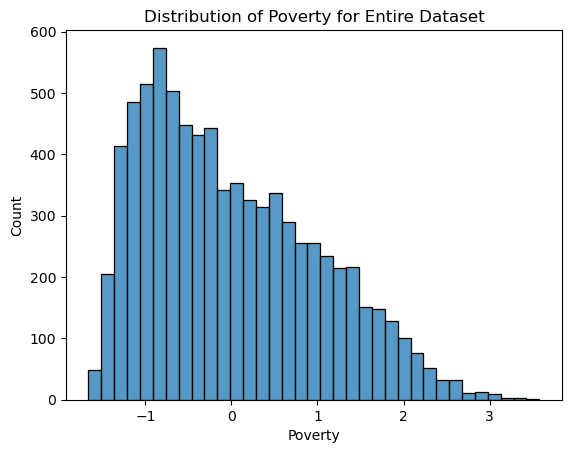

In [ ]:
sns.histplot(data=standardize(data['Poverty'])).set_title("Distribution of Poverty for Entire Dataset")

### Distribution of `Education`

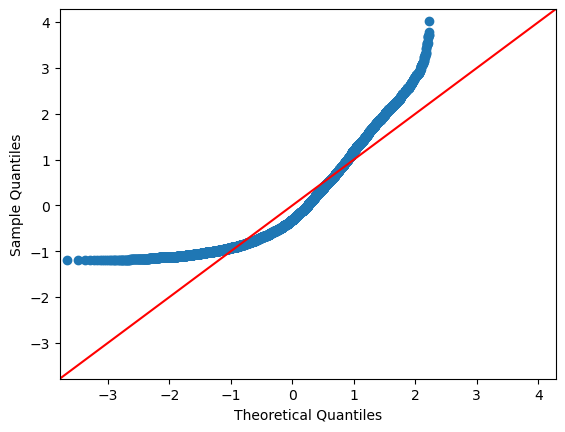

In [ ]:
hide = sm.qqplot((standardize(data['Education'])), stats.norm, line='45')

Text(0.5, 1.0, 'Education Distribution for Entire Dataset')

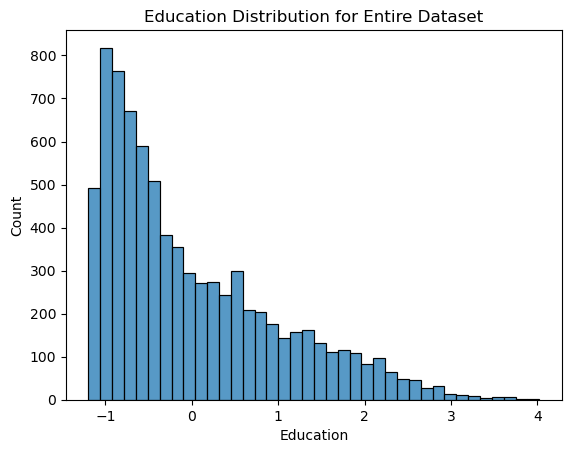

In [ ]:
sns.histplot(data=standardize(data['Education'])).set_title("Education Distribution for Entire Dataset")

### Scatterplot Between `Poverty` & `Education`

Text(0.5, 1.0, 'Education Versus Poverty for All Counties')

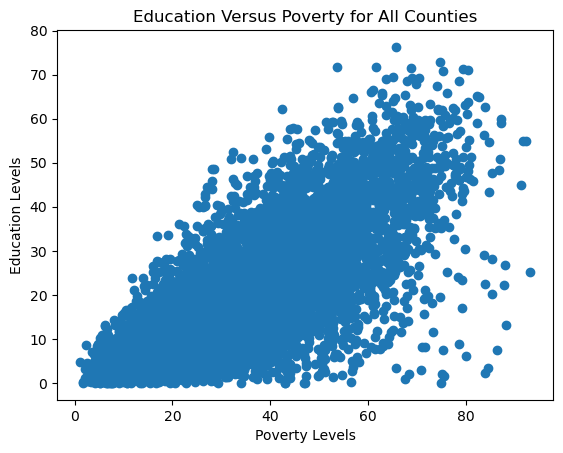

In [ ]:
plt.scatter(x=clean['Poverty'],y=clean['Education'])
plt.xlabel("Poverty Levels")
plt.ylabel("Education Levels")
plt.title("Education Versus Poverty for All Counties")

### Basic OLS Model Entire Dataset

In [ ]:
model_clean = smf.ols('Poverty ~ Education', clean).fit()
print(model_clean.summary().tables[1])

                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     14.2554      0.198     72.054      0.000      13.868      14.643
Education      0.9787      0.009    112.583      0.000       0.962       0.996


Text(0.5, 1.0, 'Regression Line for Education Versus Poverty ')

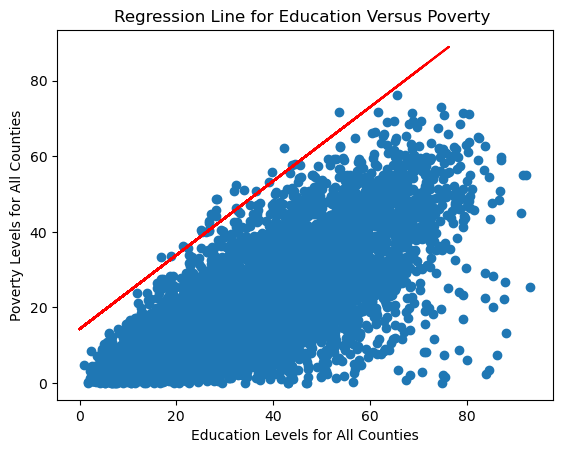

In [ ]:
plt.scatter(clean['Poverty'],clean['Education'])
plt.plot(clean['Education'], model_clean.predict(clean), color='red')
plt.xlabel("Education Levels for All Counties")
plt.ylabel("Poverty Levels for All Counties")
plt.title("Regression Line for Education Versus Poverty ")

<Axes: >

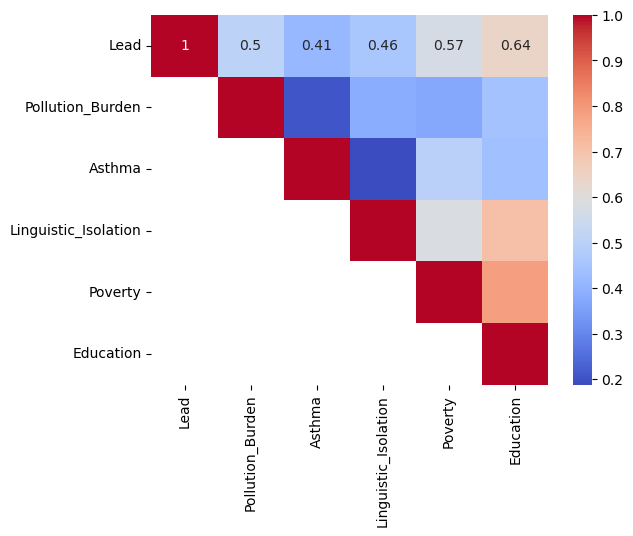

In [ ]:
drop_data = data[['Lead', 'Pollution_Burden', 'Asthma', 'Linguistic_Isolation', 'Poverty', 'Education']]
variables = drop_data.columns
corr_table = drop_data[variables].corr() 
sns.heatmap(corr_table, annot=True, cmap='coolwarm', mask=np.tril(corr_table, k=-1))

#### Poverty Shapiro-Wilk test

In [ ]:
poverty_pval = stats.shapiro(clean['Poverty']).pvalue
if poverty_pval < alpha:
    print("REJECT NULL")
else:
    print("FAIL TO REJECT NULL")

FAIL TO REJECT NULL


/Users/albertovalencia/miniconda3/lib/python3.10/site-packages/scipy/stats/_morestats.py:1882: UserWarning:

p-value may not be accurate for N > 5000.



## Applying San Diego & Los Angeles Model to Entire Dataset

In [ ]:
model = smf.ols('Education ~ Poverty + Lead + Asthma + Linguistic_Isolation + Pollution_Burden', clean).fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Education   R-squared:                       0.751
Model:                            OLS   Adj. R-squared:                  0.751
Method:                 Least Squares   F-statistic:                     4626.
Date:                Sat, 08 Jun 2024   Prob (F-statistic):               0.00
Time:                        19:42:11   Log-Likelihood:                -26177.
No. Observations:                7672   AIC:                         5.237e+04
Df Residuals:                    7666   BIC:                         5.241e+04
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
Intercept               -8.3005      0.310    -26.770      0.000      -8.908      -7.693
Poverty                  0.3413      0.007     49.675      0.000       0.328       0.355
Lead                     0.1217      0.005     24.751      0.000       0.112       0.131
Asthma                   0.0363      0.003     10.932      0.000       0.030       0.043
Linguistic_Isolation     0.5308      0.011     46.255      0.000       0.508       0.553
Pollution_Burden         0.0496      0.008      6.333      0.000       0.034       0.065
==============================================================================
Omnibus:                      189.152   Durbin-Watson:                   1.967
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              410.103
Skew:                           0.113   Prob(JB):                     8.86e-90
Kurtosis:                       4.110   Cond. No.                         354.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

# Regression Assumptions for Entire Dataset

### Linearity & Heteroscedasticity

Text(0.5, 1.0, 'Linearity & Heteroscedasticity Test for Entire Dataset Baseline')

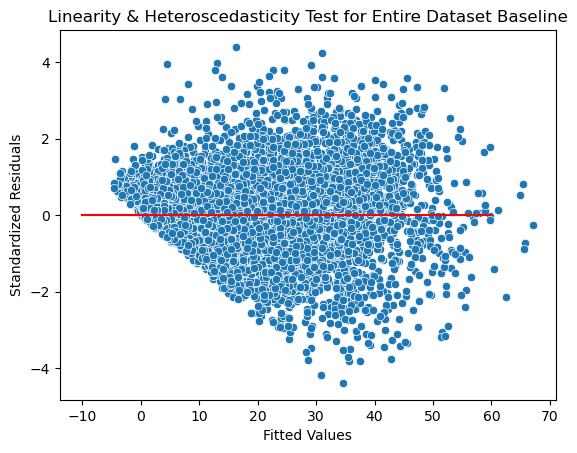

In [ ]:
sns.scatterplot(x=model.fittedvalues, y=standardize(model.resid))
plt.plot(np.linspace(-10, 60, 100), np.zeros(100), 'r')
plt.xlabel("Fitted Values")
plt.ylabel("Standardized Residuals")
plt.title("Linearity & Heteroscedasticity Test for Entire Dataset Baseline")

### Normality of Residuals

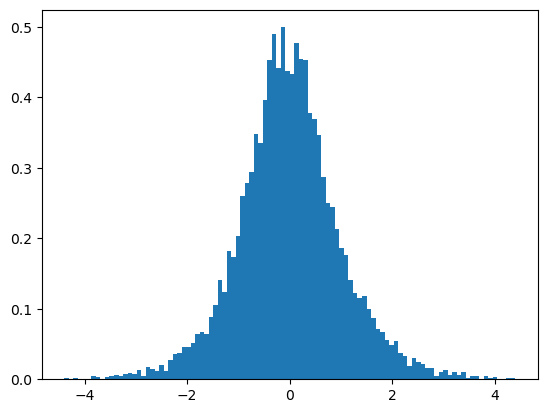

In [ ]:
hide = plt.hist(standardize(model.resid), bins=100, density=True)

In [ ]:
residuals_pvalue = stats.shapiro(standardize(model.resid)).pvalue
if residuals_pvalue < alpha:
    print("REJECT NULL")
else:
    print("FAIL TO REJECT NULL")

REJECT NULL


/Users/albertovalencia/miniconda3/lib/python3.10/site-packages/scipy/stats/_morestats.py:1882: UserWarning:

p-value may not be accurate for N > 5000.



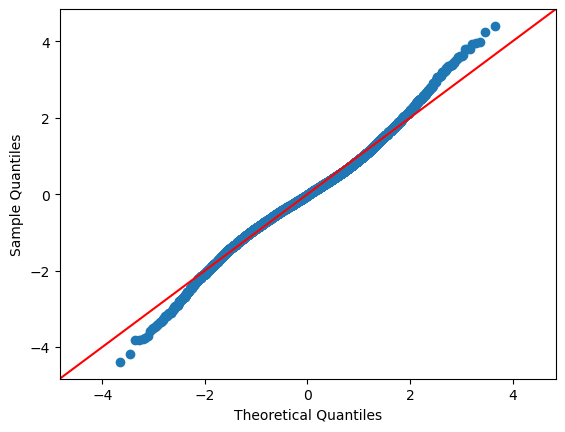

In [ ]:
qq = sm.qqplot(standardize(model.resid), stats.norm, line='45')

### Check for Independence

Text(0, 0.5, 'ACF')

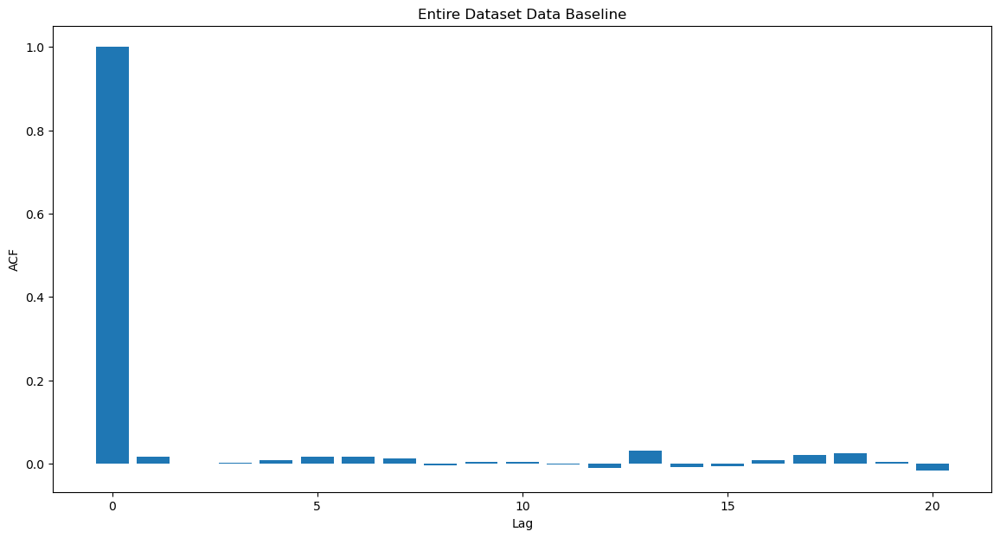

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(14, 7))

lags = 20
ax.bar(range(lags+1), acf(model.resid, nlags=lags))
ax.set_title("Entire Dataset Data Baseline")
ax.set_xlabel("Lag")
ax.set_ylabel("ACF")

### Completeness

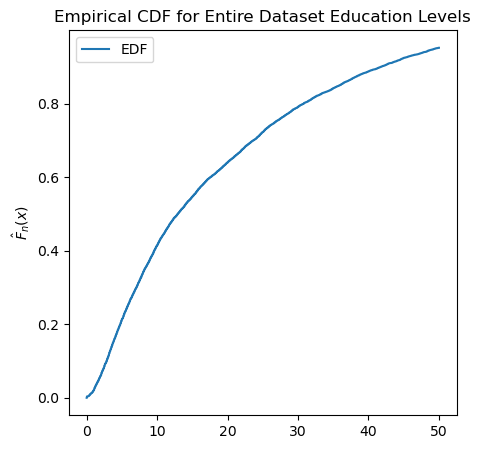

In [ ]:
xrange = np.linspace(0, 50, 1000)
sd_la_ecdf= np.array([sum(clean['Education'] < x) for x in xrange]) / len(clean)
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
ax.plot(xrange, sd_la_ecdf, label='EDF')
ax.set_ylabel(r'$\hat F_n(x)$')
ax.set_title("Empirical CDF for Entire Dataset Education Levels")
ax.legend()

## Feature Selection

In [ ]:
criterion = lambda formula, df: smf.ols(formula, data=data).fit().bic

In [ ]:
def add(df, selected_columns, columns, criterion, response='y'):
    best_criterion = np.inf
    best_column = None
    for column in columns - selected_columns:
        new_columns = selected_columns.union({column})
        formula = f'{response} ~ {" + ".join(new_columns)}'
        current_criterion = criterion(formula, df)
        if current_criterion < best_criterion:
            best_criterion = current_criterion
            best_column = column
    print(best_column)
    return selected_columns.union({best_column}), best_criterion

In [ ]:
def forward(df, criterion, response='y'):
    selected_columns = set()
    columns = set(df.columns.drop(response))
    best_criterion = np.inf
    while len(selected_columns) < len(columns):
        potential_columns, current_criterion = add(df, selected_columns, columns, criterion, response)
        if current_criterion > best_criterion:
            break
        else:
            selected_columns = potential_columns
            best_criterion = current_criterion
            print(f'Criterion: {best_criterion}')
    return selected_columns

In [ ]:
forward_vars = forward(data, criterion, response='Education')
forward_vars

Poverty
Criterion: 57280.9320387672
Linguistic_Isolation
Criterion: 53485.54569503719
Unemployment_Pctl
Criterion: 52039.65421107553
CES_40_Score
Criterion: 50901.267380100784
Low_Birth_Weight
Criterion: 50332.96806617885
Pollution_Burden
Criterion: 49737.424332036004
Lead
Criterion: 49359.280023184576
Housing_Burden_Pctl
Criterion: 48847.090839037126
California_County
Criterion: 48442.362361496635
Lead_Pctl
Criterion: 48293.8614095097
Traffic_Pctl
Criterion: 48164.651724308686
Pesticides_Pctl
Criterion: 48047.25937667351
Asthma
Criterion: 47939.396036869795
Pop_Char_Score
Criterion: 47598.062834220684
Poverty_Pctl
Criterion: 47254.54952825293
Cardiovascular_Disease_Pctl
Criterion: 46693.79152929544
Asthma_Pctl
Criterion: 46224.377189299135
Low_Birth_Weight_Pctl
Criterion: 45219.29702091114
Linguistic_Isolation_Pctl
Criterion: 40402.90244407756
CES_40_Percentile_Range
Criterion: 40237.57185220518
Unemployment
Criterion: 40184.08004993615
Longitude
Criterion: 40144.88877455766
Census_Tr

{'Asthma',
 'Asthma_Pctl',
 'CES_40_Percentile_Range',
 'CES_40_Score',
 'California_County',
 'Cardiovascular_Disease_Pctl',
 'Census_Tract',
 'Housing_Burden',
 'Housing_Burden_Pctl',
 'Latitude',
 'Lead',
 'Lead_Pctl',
 'Linguistic_Isolation',
 'Linguistic_Isolation_Pctl',
 'Longitude',
 'Low_Birth_Weight',
 'Low_Birth_Weight_Pctl',
 'Pesticides_Pctl',
 'Pollution_Burden',
 'Pop_Char_Pctl',
 'Pop_Char_Score',
 'Poverty',
 'Poverty_Pctl',
 'Traffic_Pctl',
 'Unemployment',
 'Unemployment_Pctl'}

In [ ]:
true_model_formula = 'Education ~ ' + ' + '.join(forward_vars)
model_forward = smf.ols(true_model_formula, data).fit()
model_forward.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Education   R-squared:                       0.945
Model:                            OLS   Adj. R-squared:                  0.944
Method:                 Least Squares   F-statistic:                     1302.
Date:                Sat, 08 Jun 2024   Prob (F-statistic):               0.00
Time:                        19:43:37   Log-Likelihood:                -19614.
No. Observations:                7356   AIC:                         3.942e+04
Df Residuals:                    7260   BIC:                         4.008e+04
Df Model:                          95                                         
Covariance Type:            nonrobust                                         
=======================================================================================================================
                                                          coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------------------
Intercept                                           -9564.4071   2118.479     -4.515      0.000   -1.37e+04   -5411.572
California_County[T.Alpine ]                         1.945e-05   4.37e-06      4.455      0.000    1.09e-05     2.8e-05
California_County[T.Amador ]                           -1.6525      1.749     -0.945      0.345      -5.082       1.777
California_County[T.Butte ]                            -7.0568      2.117     -3.333      0.001     -11.208      -2.906
California_County[T.Calaveras ]                       -10.7794      2.972     -3.626      0.000     -16.606      -4.953
California_County[T.Colusa ]                          -12.1285      3.745     -3.238      0.001     -19.470      -4.787
California_County[T.Contra Costa]                     -17.4441      4.208     -4.145      0.000     -25.694      -9.194
California_County[T.Del Norte]                        2.43e-11   6.09e-12      3.989      0.000    1.24e-11    3.62e-11
California_County[T.El Dorado]                        -20.6551      5.519     -3.743      0.000     -31.474      -9.837
California_County[T.Fresno ]                          -24.6612      6.167     -3.999      0.000     -36.750     -12.573
California_County[T.Glenn ]                           -28.3025      7.103     -3.985      0.000     -42.227     -14.378
California_County[T.Humboldt ]                        -34.2310      7.737     -4.424      0.000     -49.398     -19.064
California_County[T.Imperial ]                        -35.0480      8.355     -4.195      0.000     -51.426     -18.670
California_County[T.Inyo ]                            -35.7261      9.114     -3.920      0.000     -53.592     -17.860
California_County[T.Kern ]                            -41.0521      9.671     -4.245      0.000     -60.010     -22.094
California_County[T.Kings ]                           -45.1759     10.397     -4.345      0.000     -65.557     -24.795
California_County[T.Lake ]                            -50.3950     11.182     -4.507      0.000     -72.316     -28.474
California_County[T.Lassen ]                          -44.9429     11.955     -3.759      0.000     -68.378     -21.508
California_County[T.Los Angeles]                      -55.4651     12.643     -4.387      0.000     -80.249     -30.682
California_County[T.Madera ]                          -54.7028     13.215     -4.140      0.000     -80.607     -28.798
California_County[T.Marin ]                           -62.2156     14.012     -4.440      0.000     -89.684     -34.748
California_County[T.Mariposa ]                        -63.5646     14.673     -4.332      0.000     -92.327     -34.802
California_County[T.Mendocino ]                       -69.5633     15.420     -4.51

## Faulty Forward Selection Model Assumptions

### Linearity & Heteroscedasticity

Text(0, 0.5, 'Model Standardized Residuals')

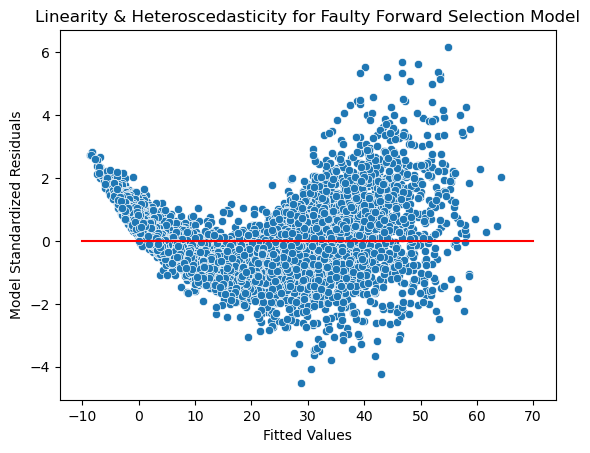

In [ ]:
sns.scatterplot(x=model_forward.predict(data), y=standardize(model_forward.resid))
plt.plot(np.linspace(-10, 70, 3), [0, 0, 0], 'r')
plt.title("Linearity & Heteroscedasticity for Faulty Forward Selection Model")
plt.xlabel("Fitted Values")
plt.ylabel("Model Standardized Residuals")

### Independence

Text(0, 0.5, 'ACF')

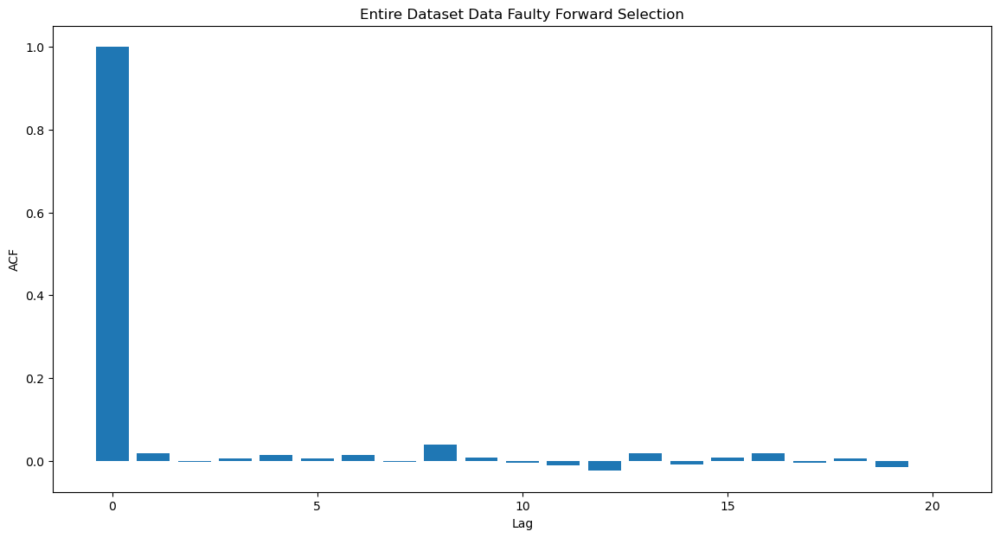

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(14, 7))

lags = 20
ax.bar(range(lags+1), acf(model_forward.resid, nlags=lags))
ax.set_title("Entire Dataset Data Faulty Forward Selection")
ax.set_xlabel("Lag")
ax.set_ylabel("ACF")

### Normality of Residuals

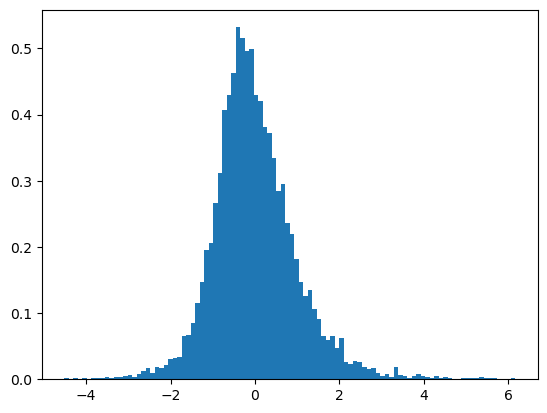

In [ ]:
hide = plt.hist(standardize(model_forward.resid), bins=100, density=True)

## Updated Forward Selection

In [ ]:
# REMOVING REDUNDANT COLUMNS

old_columns = ['ZIP', 'Longitude', 'Latitude', 'Ozone', 'Lead', 'Pesticides',
       'Traffic', 'Asthma', 'Education', 'Poverty', 'Unemployment',
       'Census_Tract', 'Total_Population', 'California_County',
       'Approximate_Location', 'CES_40_Score', 'CES_40_Percentile',
       'CES_40_Percentile_Range', 'Ozone_Pctl', 'PM25', 'PM25_Pctl',
       'Diesel_PM', 'Diesel_PM_Pctl', 'Drinking_Water', 'Drinking_Water_Pctl',
       'Lead_Pctl', 'Pesticides_Pctl', 'Tox_Release', 'Tox_Release_Pctl',
       'Traffic_Pctl', 'Cleanup_Sites', 'Cleanup_Sites_Pctl',
       'Groundwater_Threats', 'Groundwater_Threats_Pctl', 'Haz_Waste',
       'Haz_Waste_Pctl', 'Imp_Water_Bodies', 'Imp_Water_Bodies_Pctl',
       'Solid_Waste', 'Solid_Waste_Pctl', 'Pollution_Burden',
       'Pollution_Burden_Score', 'Pollution_Burden_Pctl', 'Asthma_Pctl',
       'Low_Birth_Weight', 'Low_Birth_Weight_Pctl', 'Cardiovascular_Disease',
       'Cardiovascular_Disease_Pctl', 'Linguistic_Isolation',
       'Linguistic_Isolation_Pctl', 'Poverty_Pctl', 'Unemployment_Pctl',
       'Housing_Burden', 'Housing_Burden_Pctl', 'Pop_Char_', 'Pop_Char_Score',
       'Pop_Char_Pctl']

to_remove = []
for column in old_columns:
    if "CES_40" in column:
        to_remove.append(column)
    elif "Pollution_Burden" in column:
        to_remove.append(column)
    elif "Pop_Char" in column:
        to_remove.append(column)
    elif "Pctl" in column:
        to_remove.append(column)
        
new_columns = list(set(old_columns) - set(to_remove))

In [ ]:
selection_data = data[new_columns]
selection_data.columns

Index(['Total_Population', 'Low_Birth_Weight', 'Imp_Water_Bodies',
       'Pesticides', 'Asthma', 'Drinking_Water', 'Education', 'PM25',
       'Haz_Waste', 'Groundwater_Threats', 'ZIP', 'Tox_Release', 'Lead',
       'Census_Tract', 'Longitude', 'Latitude', 'California_County',
       'Linguistic_Isolation', 'Unemployment', 'Housing_Burden', 'Traffic',
       'Poverty', 'Cardiovascular_Disease', 'Ozone', 'Approximate_Location',
       'Cleanup_Sites', 'Solid_Waste', 'Diesel_PM'],
      dtype='object')

In [ ]:
forward_vars = forward(selection_data, criterion, response='Education')
forward_vars

Poverty
Criterion: 57280.9320387672
Linguistic_Isolation
Criterion: 53485.54569503719
Unemployment
Criterion: 52041.31879448832
Lead
Criterion: 51141.00363198804
Cardiovascular_Disease
Criterion: 50564.49672135168
Low_Birth_Weight
Criterion: 50040.063545273115
California_County
Criterion: 49762.816247309136
Housing_Burden
Criterion: 49537.03919866663
Traffic
Criterion: 49405.18492591479
Total_Population
Criterion: 49353.74151121115
Pesticides
Criterion: 49327.35496608434
Solid_Waste
Criterion: 49305.454562616746
Tox_Release
Criterion: 49291.1298005717
Ozone
Criterion: 49253.26599445678
Longitude
Criterion: 49240.14154416418
Latitude
Criterion: 49218.16663756602
Census_Tract
Criterion: 49194.576836043074
Groundwater_Threats
Criterion: 49183.87254240506
Drinking_Water
Criterion: 49179.369281687555
Haz_Waste
Criterion: 49175.883635229
Diesel_PM


{'California_County',
 'Cardiovascular_Disease',
 'Census_Tract',
 'Drinking_Water',
 'Groundwater_Threats',
 'Haz_Waste',
 'Housing_Burden',
 'Latitude',
 'Lead',
 'Linguistic_Isolation',
 'Longitude',
 'Low_Birth_Weight',
 'Ozone',
 'Pesticides',
 'Poverty',
 'Solid_Waste',
 'Total_Population',
 'Tox_Release',
 'Traffic',
 'Unemployment'}

In [ ]:
# EXCLUDED VARIABLES
set(new_columns) - set(forward_vars)

{'Approximate_Location',
 'Asthma',
 'Cleanup_Sites',
 'Diesel_PM',
 'Education',
 'Imp_Water_Bodies',
 'PM25',
 'ZIP'}

In [ ]:
not_faulty_model_formula = 'Education ~ ' + ' + '.join(forward_vars)
model_forward = smf.ols(not_faulty_model_formula, data).fit()
model_forward.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Education   R-squared:                       0.803
Model:                            OLS   Adj. R-squared:                  0.801
Method:                 Least Squares   F-statistic:                     419.2
Date:                Sat, 08 Jun 2024   Prob (F-statistic):               0.00
Time:                        19:44:13   Log-Likelihood:                -24267.
No. Observations:                7355   AIC:                         4.868e+04
Df Residuals:                    7283   BIC:                         4.918e+04
Df Model:                          71                                         
Covariance Type:            nonrobust                                         
========================================================================================================
                                           coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
Intercept                            -2.397e+04   4314.653     -5.555      0.000   -3.24e+04   -1.55e+04
California_County[T.Alpine ]             0.0002   3.91e-05      5.410      0.000       0.000       0.000
California_County[T.Amador ]            -8.3036      3.431     -2.420      0.016     -15.030      -1.577
California_County[T.Butte ]            -19.7156      4.161     -4.738      0.000     -27.872     -11.559
California_County[T.Calaveras ]        -26.8332      5.983     -4.485      0.000     -38.561     -15.106
California_County[T.Colusa ]           -29.2418      7.453     -3.924      0.000     -43.851     -14.633
California_County[T.Contra Costa]      -45.3302      8.562     -5.295      0.000     -62.114     -28.547
California_County[T.Del Norte]       -3.694e-10   9.95e-11     -3.711      0.000   -5.65e-10   -1.74e-10
California_County[T.El Dorado]         -53.0439     11.176     -4.746      0.000     -74.953     -31.135
California_County[T.Fresno ]           -68.4939     12.768     -5.365      0.000     -93.522     -43.465
California_County[T.Glenn ]            -70.6232     14.311     -4.935      0.000     -98.677     -42.570
California_County[T.Humboldt ]         -86.4415     15.513     -5.572      0.000    -116.851     -56.032
California_County[T.Imperial ]         -99.1200     17.431     -5.687      0.000    -133.289     -64.951
California_County[T.Inyo ]             -96.6997     18.588     -5.202      0.000    -133.138     -60.261
California_County[T.Kern ]            -113.2333     20.050     -5.647      0.000    -152.537     -73.929
California_County[T.Kings ]           -123.4207     21.409     -5.765      0.000    -165.388     -81.453
California_County[T.Lake ]            -122.2848     22.747     -5.376      0.000    -166.876     -77.694
California_County[T.Lassen ]          -120.3629     24.108     -4.993      0.000    -167.621     -73.104
California_County[T.Los Angeles]      -149.1832     26.147     -5.705      0.000    -200.440     -97.927
California_County[T.Madera ]          -147.4352     27.059     -5.449      0.000    -200.479     -94.391
California_County[T.Marin ]           -155.9232     28.532     -5.465      0.000    -211.853     -99.993
California_County[T.Mariposa ]        -166.9230     29.981     -5.568      0.000    -225.695    -108.151
California_County[T.Mendocino ]       -170.1269     31.313     -5.433      0.000    -231.510    -108.743
California_County[T.Merced ]          -178.1921     32.824     -5.429      0.000    -242.537    -113.847
California_County[T.Modoc ]            1.99e-12   2.91e-13      6.829      0.000    1.42e-12    2.56e-12
California_County[T.Mono ]           -4.037e-12   6.93e-13     -5.828      0.000   -5.39e-12   -2.68e-12
California_County[T.Monterey ]        

## Regression Assumption Non-Faulty

#### Linearity & Homoedasticity

Text(0, 0.5, 'Model Standardized Residuals')

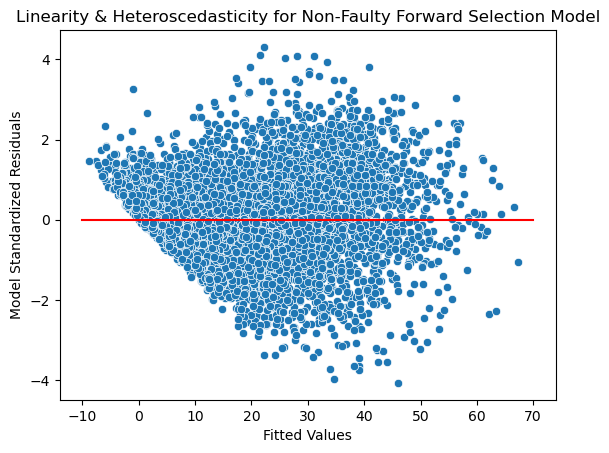

In [ ]:
sns.scatterplot(x=model_forward.predict(data), y=standardize(model_forward.resid))
plt.plot(np.linspace(-10, 70, 3), [0, 0, 0], 'r')
plt.title("Linearity & Heteroscedasticity for Non-Faulty Forward Selection Model")
plt.xlabel("Fitted Values")
plt.ylabel("Model Standardized Residuals")

#### Independence of residuals

Text(0, 0.5, 'ACF')

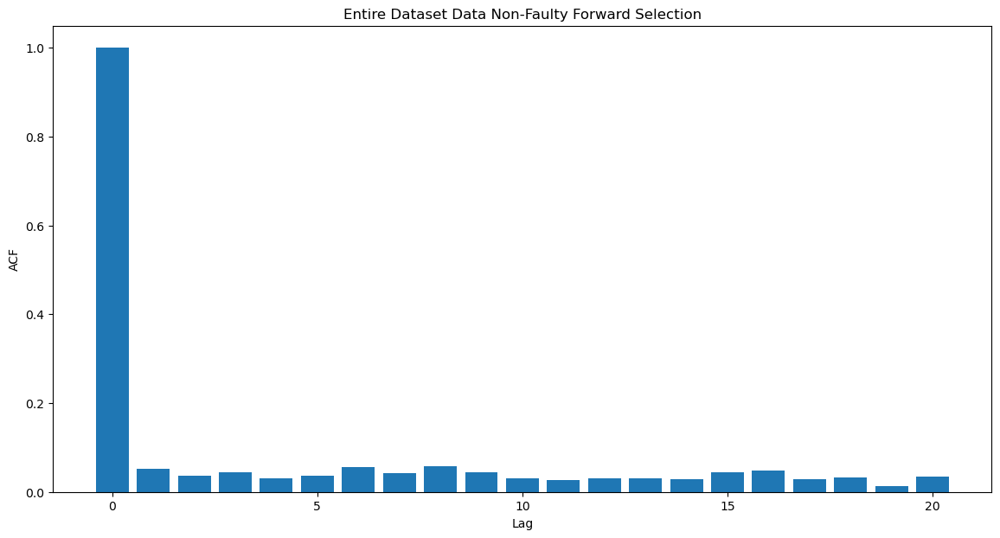

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(14, 7))

lags = 20
ax.bar(range(lags+1), acf(model_forward.resid, nlags=lags))
ax.set_title("Entire Dataset Data Non-Faulty Forward Selection")
ax.set_xlabel("Lag")
ax.set_ylabel("ACF")

### Normality of Residuals

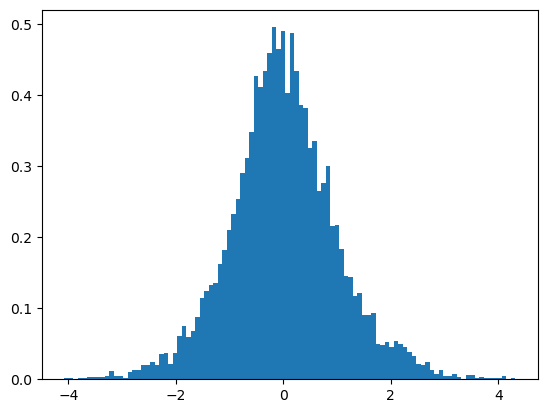

In [ ]:
hide = plt.hist(standardize(model_forward.resid), bins=100, density=True)

## Penalized Regression

### Lasso Regression Using San Diego & Los Angeles Variables

In [ ]:
lasso_model = smf.ols('Education ~ Poverty + Lead + Asthma + Linguistic_Isolation + Pollution_Burden', data).fit_regularized(method='elastic_net', alpha=0.3, L1_wt=1.0)
print(lasso_model.params[lasso_model.params > 1e-2])

Poverty                 0.323336
Lead                    0.112123
Asthma                  0.020446
Linguistic_Isolation    0.580812
dtype: float64


### Lasso Regression On All (Non-Collinear) Variables 

In [ ]:
all_variables = data.columns
updated_variables = list(set(new_columns) - set(['Education']))


full_model_formula = 'Education ~ ' + ' + '.join(updated_variables)
full_model_formula
# variables removed: 'Education', and all variables not in New Columns.

'Education ~ Longitude + Latitude + California_County + Linguistic_Isolation + Unemployment + Total_Population + Low_Birth_Weight + Housing_Burden + Imp_Water_Bodies + Traffic + Pesticides + Asthma + Poverty + Drinking_Water + Cardiovascular_Disease + Ozone + PM25 + Haz_Waste + Groundwater_Threats + ZIP + Approximate_Location + Tox_Release + Cleanup_Sites + Solid_Waste + Lead + Diesel_PM + Census_Tract'

In [ ]:
full_lasso_model = smf.ols(full_model_formula, data).fit_regularized(method='elastic_net', alpha=0.3, L1_wt=1.0)
print(full_lasso_model.params[full_lasso_model.params > 1e-2])

Linguistic_Isolation      0.507668
Low_Birth_Weight          0.190810
Asthma                    0.017947
Poverty                   0.380726
Cardiovascular_Disease    0.306206
Lead                      0.145279
dtype: float64


### Elastic Net on Our Subset

In [ ]:
elastic_net_model = smf.ols('Education ~ Poverty + Lead + Asthma + Linguistic_Isolation + Pollution_Burden', data).fit_regularized(method='elastic_net', alpha=0.3, L1_wt=.5)
print(elastic_net_model.params[elastic_net_model.params > 1e-2])

Poverty                 0.326383
Lead                    0.112683
Asthma                  0.019684
Linguistic_Isolation    0.578014
dtype: float64


### Elastic Net Model On All (Non-Collinear) Variables

In [ ]:
full_elastic_net_model = smf.ols(full_model_formula, data).fit_regularized(method='elastic_net', alpha=0.3, L1_wt=.5)
print(full_elastic_net_model.params[full_elastic_net_model.params > 1e-2])

Linguistic_Isolation      0.509947
Low_Birth_Weight          0.252703
Asthma                    0.017138
Poverty                   0.381235
Cardiovascular_Disease    0.305669
Solid_Waste               0.018079
Lead                      0.146286
dtype: float64


### Regression Model Using Variables Selected by Lasso and Elastic

In [ ]:
selected_variables_lasso = set(['Haz_Waste', 'Latitude', 'PM25', 'Linguistic_Isolation', 'Poverty', 'Asthma', 'Lead', 'Longitude'])
selected_variables_elastic = set(['Haz_Waste', 'Latitude', 'PM25', 'Low_Birth_Weight', 'Linguistic_Isolation', 'Imp_Water_Bodies', 'Poverty', 'Cardiovascular_Disease', 'Lead', 'Longitude'])   

In [ ]:
selected_variables_lasso == selected_variables_elastic

False

The variables returned by selected lasso and elastic net are different

In [ ]:
lasso_formula = 'Education ~ ' + ' + '.join(selected_variables_lasso)
elastic_formula = 'Education ~ ' + ' + '.join(selected_variables_elastic)

In [ ]:
model_lasso = smf.ols(lasso_formula, data).fit()
model_lasso.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Education   R-squared:                       0.754
Model:                            OLS   Adj. R-squared:                  0.754
Method:                 Least Squares   F-statistic:                     2939.
Date:                Sat, 08 Jun 2024   Prob (F-statistic):               0.00
Time:                        19:44:25   Log-Likelihood:                -26129.
No. Observations:                7672   AIC:                         5.228e+04
Df Residuals:                    7663   BIC:                         5.234e+04
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
Intercept               31.5896     12.136      2.603      0.009       7.800      55.379
Longitude                0.2686      0.134      2.000      0.046       0.005       0.532
Latitude                -0.1938      0.126     -1.537      0.124      -0.441       0.053
Linguistic_Isolation     0.5342      0.012     45.427      0.000       0.511       0.557
Haz_Waste                0.1628      0.059      2.742      0.006       0.046       0.279
PM25                     0.0586      0.048      1.217      0.224      -0.036       0.153
Lead                     0.1290      0.005     25.910      0.000       0.119       0.139
Asthma                   0.0434      0.003     12.709      0.000       0.037       0.050
Poverty                  0.3325      0.008     43.923      0.000       0.318       0.347
==============================================================================
Omnibus:                      200.317   Durbin-Watson:                   1.884
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              436.743
Skew:                           0.129   Prob(JB):                     1.45e-95
Kurtosis:                       4.140   Cond. No.                     2.17e+04
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.17e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
model_elastic = smf.ols(elastic_formula, data).fit()
model_elastic.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Education   R-squared:                       0.772
Model:                            OLS   Adj. R-squared:                  0.771
Method:                 Least Squares   F-statistic:                     2554.
Date:                Sat, 08 Jun 2024   Prob (F-statistic):               0.00
Time:                        19:44:25   Log-Likelihood:                -25530.
No. Observations:                7573   AIC:                         5.108e+04
Df Residuals:                    7562   BIC:                         5.116e+04
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
Intercept                -62.8714     12.821     -4.904      0.000     -88.004     -37.739
Cardiovascular_Disease     0.4938      0.020     25.042      0.000       0.455       0.533
Longitude                 -0.7591      0.143     -5.306      0.000      -1.039      -0.479
Latitude                  -1.0777      0.135     -8.004      0.000      -1.342      -0.814
Linguistic_Isolation       0.5309      0.011     46.790      0.000       0.509       0.553
Haz_Waste                  0.1601      0.058      2.770      0.006       0.047       0.273
Low_Birth_Weight           0.0338      0.055      0.612      0.541      -0.075       0.142
Imp_Water_Bodies           0.0115      0.017      0.657      0.511      -0.023       0.046
PM25                      -0.0278      0.049     -0.573      0.567      -0.123       0.067
Lead                       0.1278      0.005     26.539      0.000       0.118       0.137
Poverty                    0.3170      0.007     42.512      0.000       0.302       0.332
==============================================================================
Omnibus:                      204.080   Durbin-Watson:                   1.897
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              460.879
Skew:                           0.119   Prob(JB):                    8.34e-101
Kurtosis:                       4.185   Cond. No.                     2.21e+04
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.21e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

## Regression Assumptions for Lasso Regression

### Linearity & Heteroscedascity

/var/folders/dr/rh__6dts7h57_wbhx3rl2z900000gn/T/ipykernel_4432/3968654335.py:1: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.



Text(0, 0.5, 'Model Standardized Residuals')

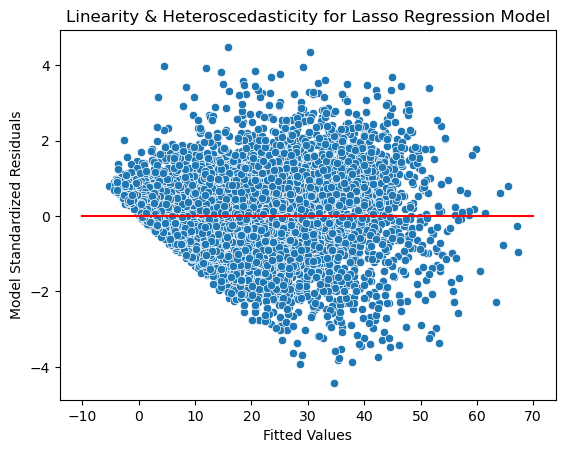

In [ ]:
sns.scatterplot(x=model_lasso.predict(data[selected_variables_lasso]), y=standardize(model_lasso.resid))
plt.plot(np.linspace(-10, 70, 3), [0, 0, 0], 'r')
plt.title("Linearity & Heteroscedasticity for Lasso Regression Model")
plt.xlabel("Fitted Values")
plt.ylabel("Model Standardized Residuals")

### Residual Normality

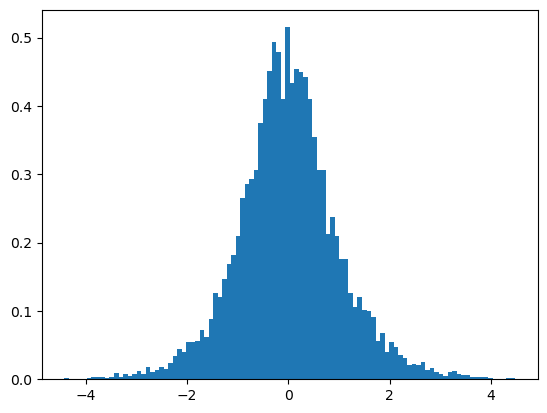

In [ ]:
hide = plt.hist(standardize(model_lasso.resid), bins=100, density=True)

### Independence

Text(0, 0.5, 'ACF')

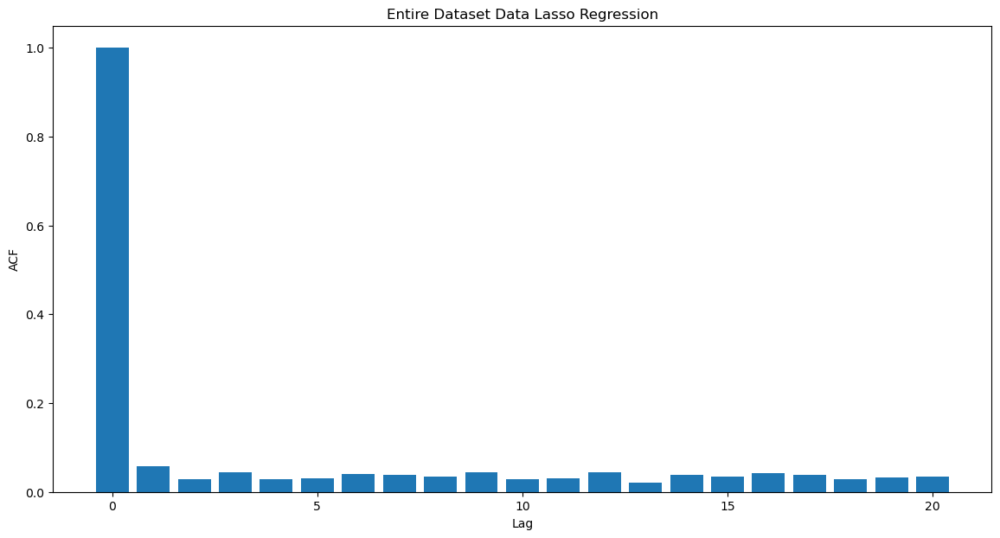

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(14, 7))

lags = 20
ax.bar(range(lags+1), acf(model_lasso.resid, nlags=lags))
ax.set_title("Entire Dataset Data Lasso Regression")
ax.set_xlabel("Lag")
ax.set_ylabel("ACF")

## Regression Assumptions for Elastic

### Linearity & Heteroscedasticity

/var/folders/dr/rh__6dts7h57_wbhx3rl2z900000gn/T/ipykernel_4432/698466261.py:1: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.



Text(0, 0.5, 'Model Standardized Residuals')

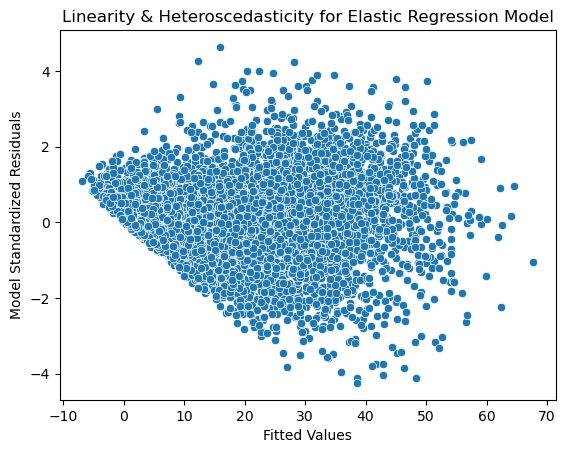

In [ ]:
sns.scatterplot(x=model_elastic.predict(data[selected_variables_elastic]), y=standardize(model_elastic.resid))
plt.title("Linearity & Heteroscedasticity for Elastic Regression Model")
plt.xlabel("Fitted Values")
plt.ylabel("Model Standardized Residuals")

### Residual Normality 

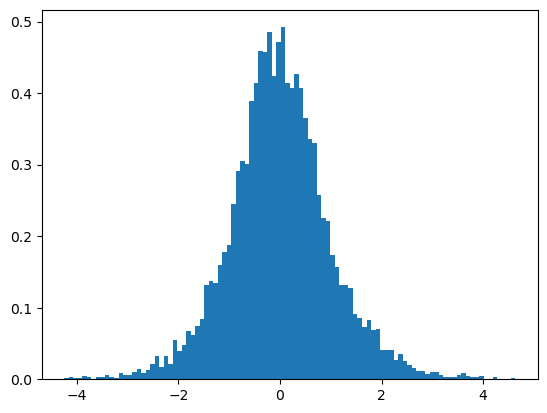

In [ ]:
hide = plt.hist(standardize(model_elastic.resid), bins=100, density=True)

### Independence

Text(0, 0.5, 'ACF')

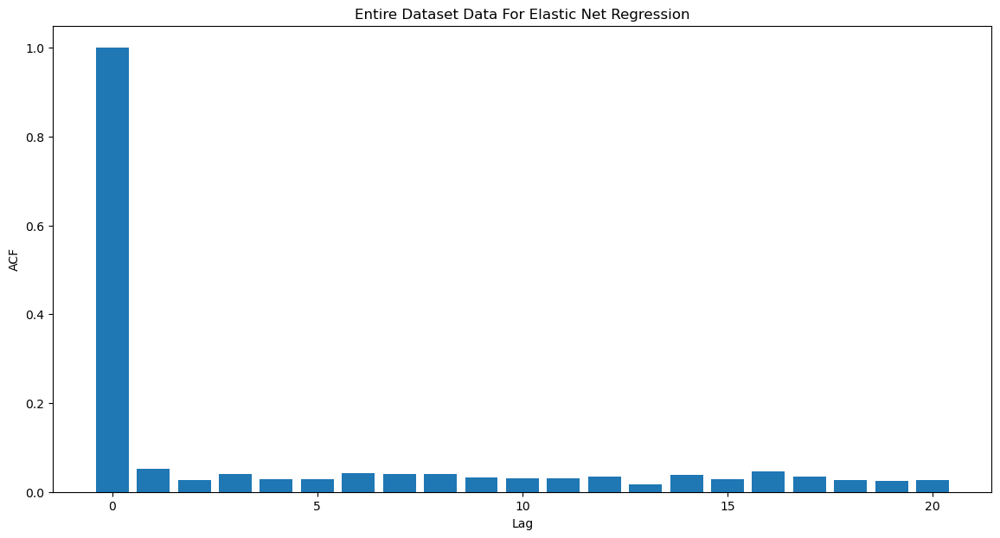

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(14, 7))

lags = 20
ax.bar(range(lags+1), acf(model_elastic.resid, nlags=lags))
ax.set_title("Entire Dataset Data For Elastic Net Regression")
ax.set_xlabel("Lag")
ax.set_ylabel("ACF")

# Newest Model

In [ ]:
common_variables = set(selected_variables_lasso).intersection(set(selected_variables_elastic))
newest_string = 'Education ~ ' + ' + '.join(common_variables)

smart_model = smf.ols(newest_string, data).fit()
smart_model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Education   R-squared:                       0.749
Model:                            OLS   Adj. R-squared:                  0.749
Method:                 Least Squares   F-statistic:                     3267.
Date:                Sat, 08 Jun 2024   Prob (F-statistic):               0.00
Time:                        19:44:26   Log-Likelihood:                -26209.
No. Observations:                7672   AIC:                         5.243e+04
Df Residuals:                    7664   BIC:                         5.249e+04
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
Intercept               29.5178     12.261      2.407      0.016       5.482      53.553
Longitude                0.3060      0.136      2.255      0.024       0.040       0.572
Latitude                -0.0068      0.127     -0.054      0.957      -0.255       0.241
Linguistic_Isolation     0.5089      0.012     43.457      0.000       0.486       0.532
Haz_Waste                0.1885      0.060      3.142      0.002       0.071       0.306
PM25                     0.1268      0.048      2.625      0.009       0.032       0.222
Lead                     0.1415      0.005     28.692      0.000       0.132       0.151
Poverty                  0.3669      0.007     51.356      0.000       0.353       0.381
==============================================================================
Omnibus:                      189.849   Durbin-Watson:                   1.877
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              435.335
Skew:                           0.074   Prob(JB):                     2.94e-95
Kurtosis:                       4.158   Cond. No.                     2.02e+04
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.02e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

## Smart Model - Regression Assumptions

### Linearity & Heteroscedasticity

Text(0, 0.5, 'Model Standardized Residuals')

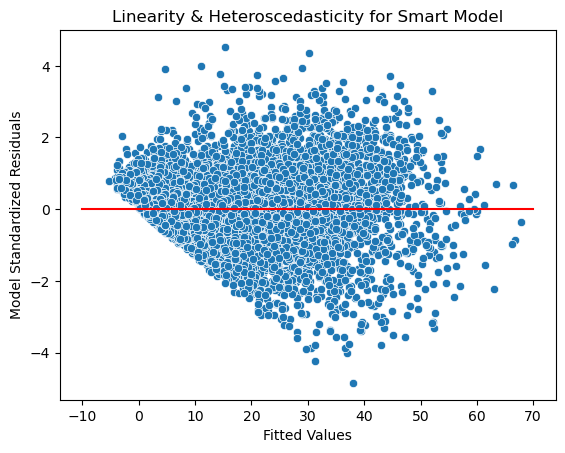

In [ ]:
sns.scatterplot(x=smart_model.fittedvalues, y=standardize(smart_model.resid))
plt.plot(np.linspace(-10, 70, 3), [0, 0, 0], 'r')
plt.title("Linearity & Heteroscedasticity for Smart Model")
plt.xlabel("Fitted Values")
plt.ylabel("Model Standardized Residuals")

### Residual Normality

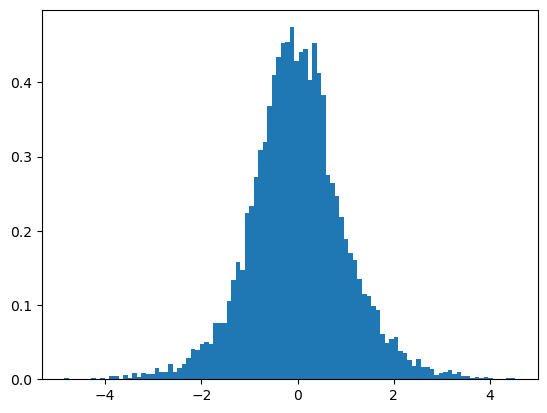

In [ ]:
hide = plt.hist(standardize(smart_model.resid), bins=100, density=True)

### Independence

Text(0, 0.5, 'ACF')

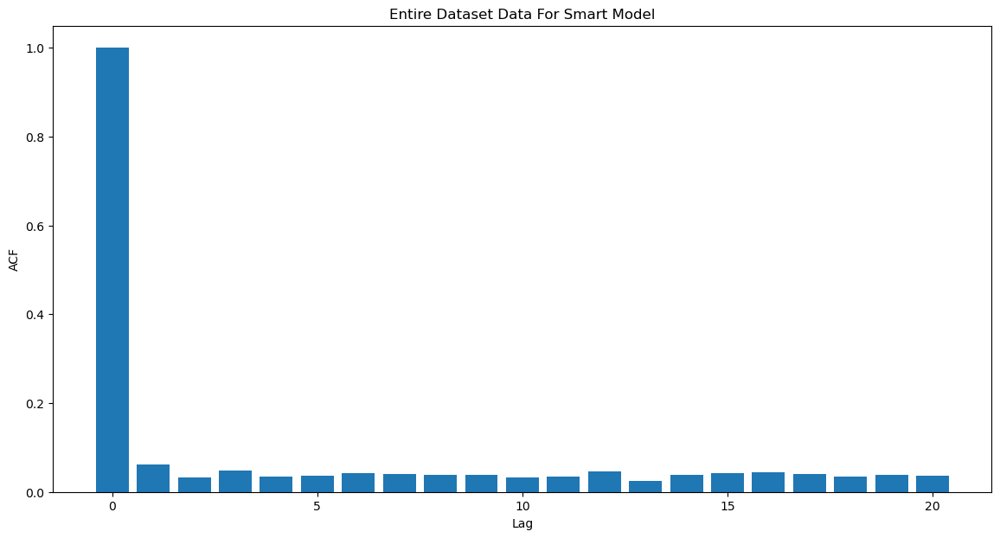

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(14, 7))

lags = 20
ax.bar(range(lags+1), acf(smart_model.resid, nlags=lags))
ax.set_title("Entire Dataset Data For Smart Model")
ax.set_xlabel("Lag")
ax.set_ylabel("ACF")

## Newest Model - Correlation Heatmap

<Axes: >

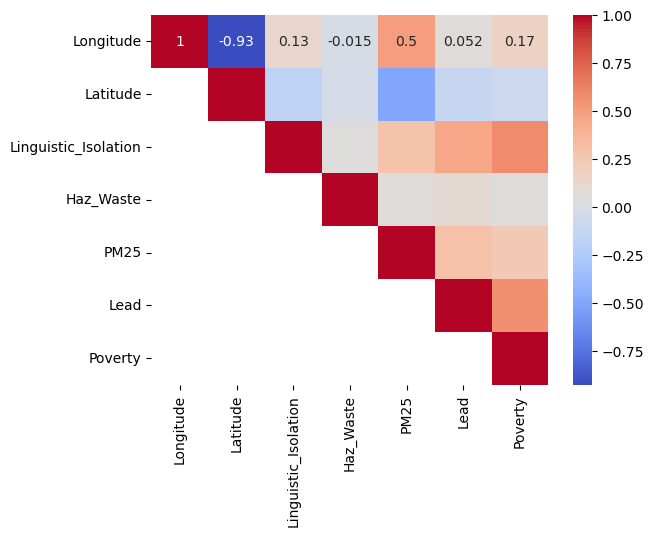

In [ ]:
corr_table = data[list(common_variables)].corr() 
sns.heatmap(corr_table, annot=True, cmap='coolwarm', mask=np.tril(corr_table, k=-1))

## Newest Model - Log of Response

In [ ]:
smart_model_data = data.copy()
for col in common_variables:
    smart_model_data = smart_model_data[(~smart_model_data[col].isna())]
smart_model_data = smart_model_data[(~smart_model_data['Education'].isna()) & (smart_model_data['Education'] > 0)]

In [ ]:
common_variables = set(selected_variables_lasso).intersection(set(selected_variables_elastic))
lognewest_string = 'np.log(Education) ~ ' + ' + '.join(common_variables)

smart_model_log = smf.ols(newest_string, smart_model_data).fit()
smart_model_log.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Education   R-squared:                       0.750
Model:                            OLS   Adj. R-squared:                  0.749
Method:                 Least Squares   F-statistic:                     3267.
Date:                Sat, 08 Jun 2024   Prob (F-statistic):               0.00
Time:                        19:44:28   Log-Likelihood:                -26105.
No. Observations:                7646   AIC:                         5.223e+04
Df Residuals:                    7638   BIC:                         5.228e+04
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
Intercept               26.6719     12.257      2.176      0.030       2.645      50.698
Longitude                0.2738      0.136      2.019      0.044       0.008       0.540
Latitude                -0.0341      0.126     -0.270      0.788      -0.282       0.214
Linguistic_Isolation     0.5067      0.012     43.315      0.000       0.484       0.530
Haz_Waste                0.1836      0.060      3.066      0.002       0.066       0.301
PM25                     0.1282      0.048      2.655      0.008       0.034       0.223
Lead                     0.1399      0.005     28.341      0.000       0.130       0.150
Poverty                  0.3695      0.007     51.668      0.000       0.355       0.384
==============================================================================
Omnibus:                      187.745   Durbin-Watson:                   1.878
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              423.588
Skew:                           0.084   Prob(JB):                     1.04e-92
Kurtosis:                       4.141   Cond. No.                     2.02e+04
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.02e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Text(0, 0.5, 'Model Standardized Residuals')

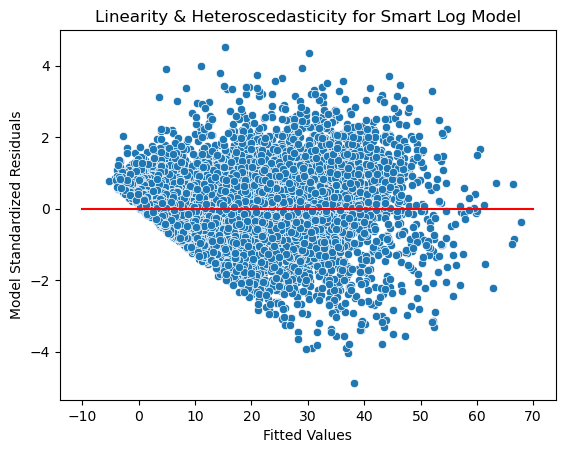

In [ ]:
sns.scatterplot(x=smart_model_log.fittedvalues, y=standardize(smart_model_log.resid))
plt.plot(np.linspace(-10, 70, 3), [0, 0, 0], 'r')
plt.title("Linearity & Heteroscedasticity for Smart Log Model")
plt.xlabel("Fitted Values")
plt.ylabel("Model Standardized Residuals")

## Newest Model - Interaction Terms

In [ ]:
all_subsets = itertools.combinations(common_variables,2)
interactive_terms = []
for a,b in all_subsets:
    interactive_term = f'{a}:{b}'
    interactive_terms.append(interactive_term)

In [ ]:
final_model_formula = 'Education ~ ' + ' + '.join(common_variables) + ' + ' + ' + '.join(interactive_terms)
final_model_formula

'Education ~ Longitude + Latitude + Linguistic_Isolation + Haz_Waste + PM25 + Lead + Poverty + Longitude:Latitude + Longitude:Linguistic_Isolation + Longitude:Haz_Waste + Longitude:PM25 + Longitude:Lead + Longitude:Poverty + Latitude:Linguistic_Isolation + Latitude:Haz_Waste + Latitude:PM25 + Latitude:Lead + Latitude:Poverty + Linguistic_Isolation:Haz_Waste + Linguistic_Isolation:PM25 + Linguistic_Isolation:Lead + Linguistic_Isolation:Poverty + Haz_Waste:PM25 + Haz_Waste:Lead + Haz_Waste:Poverty + PM25:Lead + PM25:Poverty + Lead:Poverty'

In [ ]:
final_model = smf.ols(final_model_formula, smart_model_data).fit()
final_model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Education   R-squared:                       0.796
Model:                            OLS   Adj. R-squared:                  0.795
Method:                 Least Squares   F-statistic:                     1063.
Date:                Sat, 08 Jun 2024   Prob (F-statistic):               0.00
Time:                        19:44:28   Log-Likelihood:                -25319.
No. Observations:                7646   AIC:                         5.070e+04
Df Residuals:                    7617   BIC:                         5.090e+04
Df Model:                          28                                         
Covariance Type:            nonrobust                                         
==================================================================================================
                                     coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
Intercept                      -1292.3417    162.234     -7.966      0.000   -1610.366    -974.318
Longitude                        -11.3080      1.384     -8.172      0.000     -14.021      -8.595
Latitude                          22.4154      4.323      5.185      0.000      13.941      30.890
Linguistic_Isolation               1.9038      1.322      1.440      0.150      -0.687       4.495
Haz_Waste                         14.1750     10.244      1.384      0.166      -5.907      34.257
PM25                              85.3291      5.603     15.229      0.000      74.346      96.313
Lead                              -3.2126      0.640     -5.016      0.000      -4.468      -1.957
Poverty                           -1.0882      0.798     -1.364      0.173      -2.652       0.476
Longitude:Latitude                 0.1995      0.035      5.640      0.000       0.130       0.269
Longitude:Linguistic_Isolation     0.0453      0.016      2.887      0.004       0.015       0.076
Longitude:Haz_Waste                0.1603      0.113      1.413      0.158      -0.062       0.383
Longitude:PM25                     0.8964      0.060     14.880      0.000       0.778       1.014
Longitude:Lead                    -0.0437      0.007     -6.122      0.000      -0.058      -0.030
Longitude:Poverty                 -0.0188      0.009     -2.093      0.036      -0.036      -0.001
Latitude:Linguistic_Isolation      0.1190      0.017      6.839      0.000       0.085       0.153
Latitude:Haz_Waste                 0.1179      0.111      1.062      0.288      -0.100       0.336
Latitude:PM25                      0.5913      0.053     11.198      0.000       0.488       0.695
Latitude:Lead                     -0.0582      0.007     -8.343      0.000      -0.072      -0.045
Latitude:Poverty                  -0.0312      0.009     -3.496      0.000      -0.049      -0.014
Linguistic_Isolation:Haz_Waste     0.0017      0.008      0.204      0.839      -0.015       0.018
Linguistic_Isolation:PM25         -0.0423      0.005     -7.699      0.000      -0.053      -0.032
Linguistic_Isolation:Lead          0.0050      0.001      8.194      0.000       0.004       0.006
Linguistic_Isolation:Poverty      -0.0013      0.001     -2.249      0.025      -0.002      -0.000
Haz_Waste:PM25                     0.0925      0.048      1.938      0.053      -0.001       0.186
Haz_Waste:Lead                     0.0120      0.003      3.477      0.001       0.005       0.019
Haz_Waste:Poverty                 -0.0191      0.005     -4.057      0.000      -0.028      -0.010
PM25:Lead                          0.0047      0.003      1.675      0.094      -0.001       0.010
PM25:Poverty                       0.0127      0.004      3.544      0.000       0.006       0.020
Lead:Poverty  

## Final Model - Interaction Terms Regression Assumptions

### Linearity & Heteroscedasticity

Text(0, 0.5, 'Model Standardized Residuals')

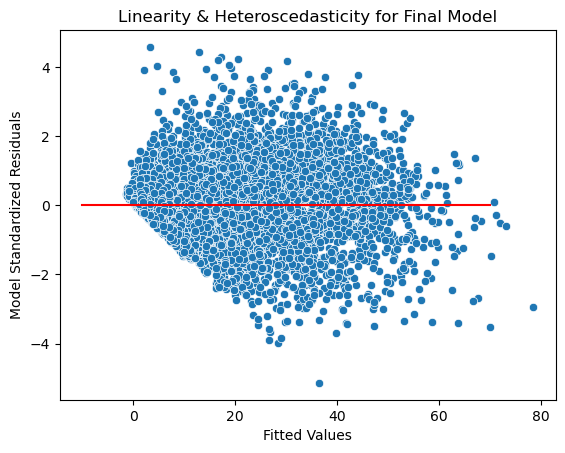

In [ ]:
sns.scatterplot(x=final_model.fittedvalues, y=standardize(final_model.resid))
plt.plot(np.linspace(-10, 70, 3), [0, 0, 0], 'r')
plt.title("Linearity & Heteroscedasticity for Final Model")
plt.xlabel("Fitted Values")
plt.ylabel("Model Standardized Residuals")

### Residual Normality

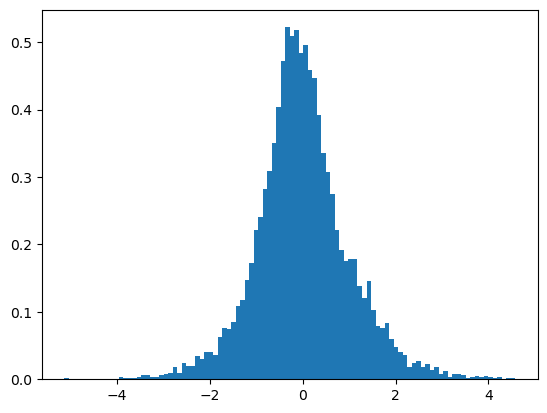

In [ ]:
hide = plt.hist(standardize(final_model.resid), bins=100, density=True)

### Independence

Text(0, 0.5, 'ACF')

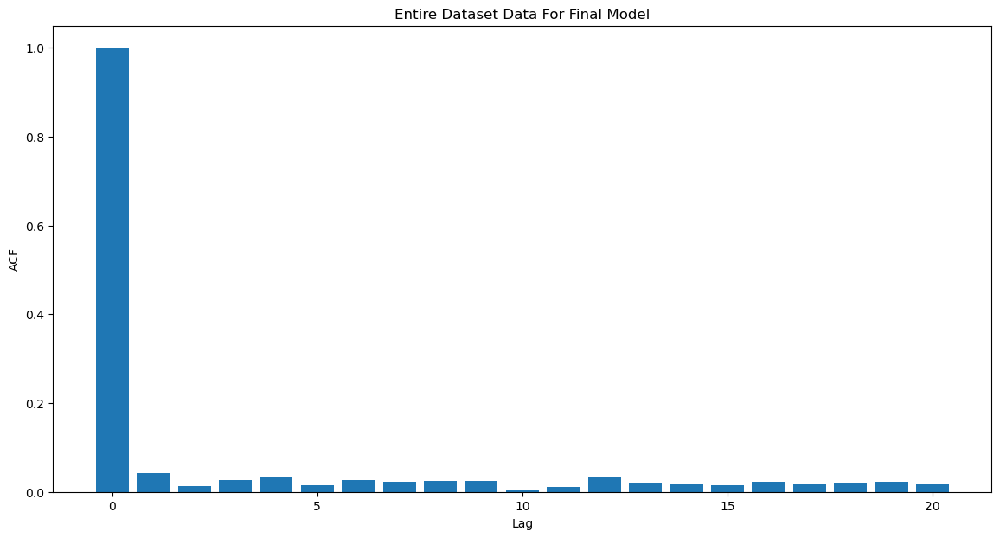

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(14, 7))

lags = 20
ax.bar(range(lags+1), acf(final_model.resid, nlags=lags))
ax.set_title("Entire Dataset Data For Final Model")
ax.set_xlabel("Lag")
ax.set_ylabel("ACF")

# Newest Model Choropleth

In [ ]:
clean['fip'] = clean['ZIP'].apply(dic)
clean['pred'] = pd.Series(smart_model.fittedvalues)

grouped = clean[['fip', 'Education', 'pred']].groupby('fip').mean().reset_index()


In [ ]:
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

fig = px.choropleth(grouped,
                    geojson=counties, 
                    locations='fip', 
                    color='Education',
                    range_color=(0, 100),
                    scope="usa"
                    )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

# Final Model Choropleth

In [ ]:
clean['fip'] = clean['ZIP'].apply(dic)
clean['pred'] = pd.Series(final_model.fittedvalues)

grouped = clean[['fip', 'Education', 'pred']].groupby('fip').mean().reset_index()

In [ ]:
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

fig = px.choropleth(grouped,
                    geojson=counties, 
                    locations='fip', 
                    color='Education',
                    range_color=(0, 100),
                    scope="usa"
                    )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

### Choropleth Resource Links
- https://plotly.com/python/choropleth-maps/
- https://stackoverflow.com/questions/73668088/can-we-use-plotly-express-to-plot-zip-codes